## Generating the plot for the stochastic signal that LISA measures considering an observationally motivated population model for the Compact Galactic Binaries model

A script that takes the output of the signal reduction algorithm described in [PRD 104, 043019](https://journals.aps.org/prd/abstract/10.1103/PhysRevD.104.043019), and generates the plot of the data in $h_c$ units.

To make this notebook work we need to install the LDC software which can be found [here](https://lisa-ldc.lal.in2p3.fr/).

Valeriya Korol and NK, 2023

In [2]:
import numpy as np
# For those, the LDC software needs to be installed. It can be found here: https://lisa-ldc.lal.in2p3.fr/
import pickle
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import corner
import ldc.io.hdf5 as h5io
from ldc.lisa.noise import get_noise_model                                                                                                                                                                 
import textwrap

from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

from matplotlib import rc  #This does not work for Valeriya on COlab
rc('font',**{'family':'serif','serif':['TX Times']})
rc('text', usetex=True)

%matplotlib inline

In [3]:
with open('/Users/irwin/Documents/GitHub/lisa-ml/data/data_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.pkl', 'rb') as filehandle:
    data_1 = pickle.load(filehandle)

In [10]:
data_1['f'][1]

<xarray.DataArray 'f' ()> Size: 8B
array(7.92188395e-09)
Coordinates:
    f        float64 8B 7.922e-09
Attributes:
    units:    Hz

There are a couple of keys in that dictionary. Those are the 
* `'f'`: Frequencies of the analysis.
* `'AET'`: The A, E, T channels of the residual galaxy. Basically the FFT of the data
* `'S1'`:  The smoothed residuals plus the instrumental noise.
* `'S1r'`: In some cases we do some extra smoothing on the data. Here we store only the 'raw' running median on the PSD for cross-checking, and in `'S1'` we store the more smoothed data. In most cases though this is the same data repeated because we do not use any extra smoothing.

In [5]:
# Get the catalogue in HDF5 format.
cats, units = h5io.load_array('/Users/irwin/Documents/GitHub/lisa-ml/data/resolved_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.h5', 'cat')
                              #(cat_path + 'resolved_' + cat_name_1 + '.h5', 'cat') #resolved_DWDs_NSWDs_MW_test_tot_pow_NEW.h5'
names_1 = cats['Name']
f0_1    = cats['Frequency'] # Extract the parameters
Amp0_1  = cats['Amplitude']
fdot0_1 = cats['FrequencyDerivative']
snr_1 = np.sqrt(cats['snr2'])
fconf = data_1['f']     # The frequency array of the data
ecc_1 = cats['Eccentricity']
incl_1 = cats['Inclination']
pol_1 = cats['Polarization']
elplang_1 = cats['EclipticLatitude']
elplong_1 = cats['EclipticLongitude']
iniphase_1 = cats['InitialPhase']

In [6]:
cats

array([('MW_DWD 0', 0.00583149, 9.18299115e-16, -0.35897321, -1.7963785 , 4.04840582e-23, 1.4397602 , 0.18878105, 1.74356684, 0.        , 1.67523827e+03),
       ('MW_DWD 305', 0.00103268, 1.02751254e-18, -0.04865936,  2.6693584 , 7.38113554e-23, 2.17472739, 5.5670649 , 0.6146168 , 0.        , 1.60373763e+02),
       ('MW_DWD 336', 0.00139411, 3.08784824e-18, -0.63050873, -1.94306869, 1.64368164e-23, 0.39633253, 5.02939386, 1.03519694, 0.        , 5.61717165e+01),
       ('MW_DWD 343', 0.0015629 , 4.69521312e-18, -0.42881544, -1.82398772, 2.13141403e-23, 0.35534529, 0.95990203, 1.6426564 , 0.        , 1.59492169e+02),
       ('MW_DWD 345', 0.00161474, 5.29197290e-18, -0.09710558, -1.67409916, 1.54487989e-23, 0.41627725, 6.1377347 , 0.22278233, 0.        , 9.37887899e+01),
       ('MW_DWD 348', 0.00173776, 6.92679289e-18, -0.54744683, -1.93162866, 1.72808771e-23, 0.17974166, 1.85385626, 6.19733526, 0.        , 1.69928287e+02),
       ('MW_DWD 349', 0.00177836, 7.53888282e-18, -0.2583427

In [7]:
# Convert to Pandas DataFrame
df = pd.DataFrame(cats)

# Display the original DataFrame
print("Original DataFrame:")
print(df)

# Identify duplicates based on 'Name'
# For each 'Name', keep the row with the maximum 'Amplitude'
df_unique = df.loc[df.groupby('Name')['Amplitude'].idxmax()]

# Alternatively, if you want to sort and drop duplicates:
# df_sorted = df.sort_values('Amplitude', ascending=False)
# df_unique = df_sorted.drop_duplicates(subset='Name', keep='first')

# Reset index if necessary
df_unique.reset_index(drop=True, inplace=True)

# Display the DataFrame after removing duplicates
print("\nDataFrame after removing duplicates (keeping highest Amplitude):")
print(df_unique)

# (Optional) Convert back to a NumPy structured array
unique_data = df_unique.to_records(index=False)

# Display the unique NumPy array
print("\nUnique NumPy Structured Array:")
print(unique_data)

NameError: name 'pd' is not defined

In [8]:
names_1 = unique_data['Name']
f0_1    = unique_data['Frequency'] # Extract the parameters
Amp0_1  = unique_data['Amplitude']
fdot0_1 = unique_data['FrequencyDerivative']
snr_1 = np.sqrt(unique_data['snr2'])
fconf = unique_data['Frequency']     # The frequency array of the data
ecc_1 = unique_data['Eccentricity']
incl_1 = unique_data['Inclination']
pol_1 = unique_data['Polarization']
elplang_1 = unique_data['EclipticLatitude']
elplong_1 = unique_data['EclipticLongitude']
iniphase_1 = unique_data['InitialPhase']

NameError: name 'unique_data' is not defined

In [135]:
len(names_1)

897

In [8]:
units

{'Amplitude': '1',
 'Eccentricity': '1',
 'EclipticLatitude': 'rad',
 'EclipticLongitude': 'rad',
 'Frequency': 'Hz',
 'FrequencyDerivative': 'Hz2',
 'Inclination': 'rad',
 'InitialPhase': 'rad',
 'Polarization': 'rad'}

In [9]:
parameter_names = [
    'Frequency_mHz',
    'FrequencyDerivative_log10',
    'EclipticLatitude_sin',
    'EclipticLongitude',
    'Amplitude_log10',
    'Inclination_cos',
    'Polarization',
    'InitialPhase'
]

In [10]:
print(np.argmin(snr_1))
print(np.argmax(snr_1))
print(np.argmin(f0_1))
print(np.argmax(f0_1))

966
944
954
520


In [11]:
f0_1[966]
Amp0_1[966]
fdot0_1[966]
snr_1[966]
ecc_1[966]

0.0

In [12]:
names_1[520]

'MW_DWD 17327'

In [13]:
d = (2*5*3e+8*fdot0_1/(96.*np.pi**2.*f0_1**3.*Amp0_1))/3.09e19
Mchirp = ((3e+8**3/6.67e-11)*(5./96.*fdot0_1*np.pi**(-8./3.)*f0_1**(-11./3.))**(3./5.))/1.99e30

In [14]:
len(snr_1)

971

In [15]:
from ldc.common.constants import SPEED_OF_LIGHT, GM_SUN, PARSEC, ASTRONOMICAL_YEAR

# Estimate luminosity distance (in kpc) from GW amplitude, frequency, and frequency derivative
def get_DL(Amp0, f0, fdot):
    return (5/(96*(np.pi**2)))*(SPEED_OF_LIGHT/Amp0)*(fdot)/np.power(f0,3)*(1/(1000*PARSEC))

# Estimate chirp Mass
def get_Mc(f0, fdot):
    return SPEED_OF_LIGHT**3/GM_SUN * ( (5/96) * np.pi**(-8/3) * f0**(-11/3) * fdot)**(3/5)

dL_1    = get_DL(Amp0_1, f0_1, fdot0_1) # Transform to the distances and chirp masses
Mchrp_1 = get_Mc(f0_1, fdot0_1)

In [16]:
# LISA's noise curve 
Tobs     = 4*ASTRONOMICAL_YEAR                # Duration of the measurement
f        = np.linspace(1e-4,1e-1,1000)        # The frequency array

lisa_noise = get_noise_model('SciRDv1', f)

In [17]:
# Define the sky-averaged response function
def response_AE(f):
    """
    The sky averaged LISA response function for the A and E TDI channels.
    """
    lisaLT = lisa_noise.arm_length/SPEED_OF_LIGHT
    x = 2.0 * np.pi * lisaLT * f 
    return np.absolute(9/20 /(1 + (3 *x/4)**2 ) * ((16 * x**2 * np.sin(x)**2))) / 2

In [18]:
def compute_hGB(Mchrp, f0, dL):
    """
    Compute the point signals of the recovered binaries. 
    Taken from arXiv:1803.01944 (see eq. (27) )
    
    Mchirp - The chirp mass
    f0     - Source frequency
    dL     - The distance
    
    """
    nom   = 8*np.sqrt(Tobs)*(GM_SUN*Mchrp/SPEED_OF_LIGHT**3)**(5/3) * np.pi**(2/3) * f0**(2/3) 
    denom = np.sqrt(5) * dL * (1000*PARSEC) / SPEED_OF_LIGHT
    return nom/denom

# Compute the strain amplitude of the resolved sources in order to verify the 
# computation of the dots in the plot. Uncomment lines in the next cell in order
# to actuall plot those data.
resolved_sources_1 = compute_hGB(Mchrp_1, f0_1, dL_1)

In [19]:
# Compute the sensitivity
lisasens = lisa_noise.sensitivity()

Compute the PSD of the residuals, becasue in `'S1'` it's the GB confusion plust hte instrumental noise

In [20]:
df = np.abs(fconf[1]-fconf[0]) # Get the freq. resolution

# Compute the PSD
conf_psd_1 = 2 * df * np.absolute(data_1['AET']['A'])**2 

from scipy import ndimage

# Do the running median on the PSD, normalize with a constant to account for bias of mean vs median
conf_psd_smoothed_1 = ndimage.median_filter(conf_psd_1, size=2000) / 0.7023319615912207

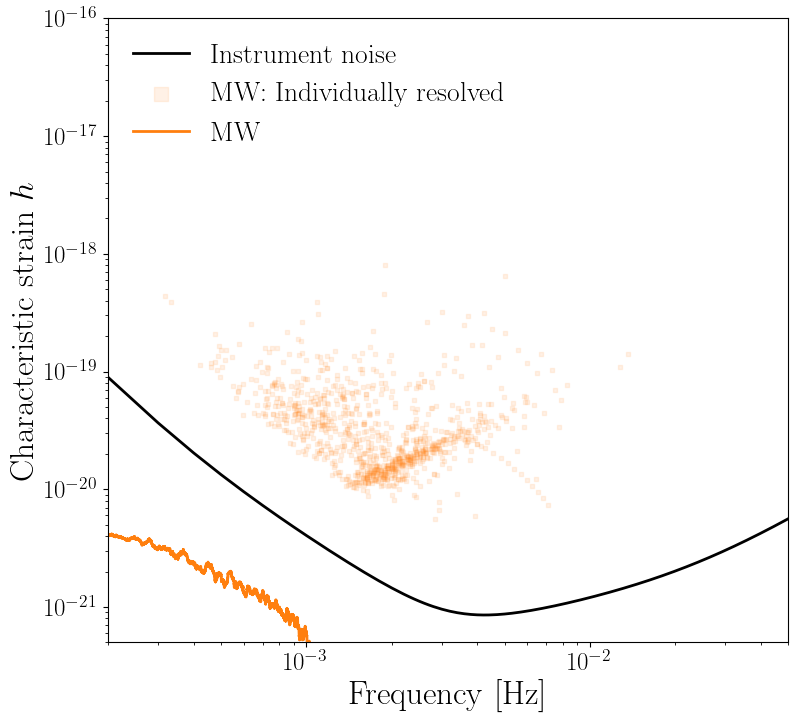

In [21]:
fig, ax1 = plt.subplots(figsize=(8,8)) 
plt.subplots_adjust(left=0.13, right=0.98, top=0.9, bottom=0.12)

### Sensitivity
plt.loglog(f, np.sqrt( f * lisasens/2), 'k-', linewidth=2, label='Instrument noise')
# plt.loglog(f, np.sqrt( f * conf_default_plusnoise/2), lw=2, label='Default BPS unresolved foreground plus instrument noise', linestyle='--', color='gray', alpha=.5) 

### New foreground signal: Individually detected 
plt.scatter(f0_1, np.sqrt(16/5) * np.sqrt(Tobs*f0_1) * Amp0_1, s=10, marker='s', edgecolor=None, color='C1', alpha=.1, label='MW: Individually resolved')
#plt.scatter(f0_2, np.sqrt(16/5) * np.sqrt(Tobs*f0_2) * Amp0_2, s=10, edgecolor=None, color='mediumseagreen', alpha=.1, label='MW + NSWDs: Individually resolved')

# This is where I plot the eq. (26) from arXiv:1803.01944, and it overlaps with the one above.
# I need a factor of two, which comes from the fact that in the paper above they are using a 
# sensitivity a factor of 2 lower than what is implemented for the LDC. In LDC they use the 
# S_{h,X}, which is based on the X channel, while if we use the combined sinsitivity we have
# to divide by 2. This is explained above eq. (43) in arXiv:2108.01167. Thus, I will use the
# definitions of arXiv:1803.01944, while dividing all other quantities by a factor of 2.
# 
# plt.scatter(f0, np.sqrt(f0)/2 * resolved_sources, s=10, edgecolor=None, color='crimson', alpha=0.3, label='Individually resolved (eq. 27) of arXiv:1803.01944')

### Foreground
plt.loglog(fconf, np.sqrt(conf_psd_smoothed_1*fconf/response_AE(fconf)/2), 'C1-', lw=2, label='MW')
#plt.loglog(fconf, np.sqrt(conf_psd_smoothed_2*fconf/response_AE(fconf)/2), 'mediumseagreen', lw=2, label='MW + NSWDs')

### Plot settings
plt.xlabel(r'Frequency [Hz]', fontsize=24)
plt.ylabel(r'Characteristic strain $h$', fontsize = 24)
plt.ylim([5e-22,1e-16])
plt.xlim([2e-4,5e-2])

plt.yscale('log')
plt.xscale('log')
plt.tick_params(axis='both', which='major', labelsize=18) 
plt.legend(fontsize=20, frameon=False, loc='upper left', markerscale=3.)
#plt.savefig('Characteristic_strain_plot.pdf')
plt.show()

In [23]:
with open('./data/fims_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.pkl', 'rb') as filehandle:
    data_fim = pickle.load(filehandle)

FileNotFoundError: [Errno 2] No such file or directory: './data/fims_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.pkl'

## Reproducing Fig 3. LEGWORK

In this exercise we will be reproducing the graph as presented in the LEGWORK paper, specifically Figure 3.  

In [25]:
import legwork.visualisation as vis
from legwork import source, psd
import astropy.units as u
import legwork as lw
import matplotlib.pyplot as plt

In [24]:
%config InlineBackend.figure_format = 'retina'

plt.rc('font', family='serif')
plt.rcParams['text.usetex'] = False
fs = 24

# update various fontsizes to match
params = {'figure.figsize': (12, 8),
          'legend.fontsize': fs,
          'axes.labelsize': fs,
          'xtick.labelsize': 0.9 * fs,
          'ytick.labelsize': 0.9 * fs,
          'axes.linewidth': 1.1,
          'xtick.major.size': 7,
          'xtick.minor.size': 4,
          'ytick.major.size': 7,
          'ytick.minor.size': 4}
plt.rcParams.update(params)

For this plot, we vary eccentricity from 0 to 0.9 keeping the masses of the binary same (or the chirp mass), the frequency of the orbitals and the distance between them the same. We then extract out the signal to noise ratio of the evolving eccentric orbit

In [25]:
# set eccentricities
ecc = np.array([1e-6, 0.1,0.2,0.4,0.5, 0.6, 0.9])
n_binaries = len(ecc)

# use constant values for mass, f_orb and distance
m_1 = np.repeat(0.6, n_binaries) * u.Msun
m_2 = np.repeat(0.6, n_binaries) * u.Msun
f_orb = np.repeat(1.5e-3, n_binaries) * u.Hz
dist = np.repeat(15, n_binaries) * u.kpc
# get the SNR in each harmonic
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5)

In [26]:
print(snr)

[31.83881026 32.59797207 34.74880781 41.89993689 46.1455579  50.31022837
 38.94696211]


In [27]:
print(snr2_n.shape)

(7, 100)


findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the 

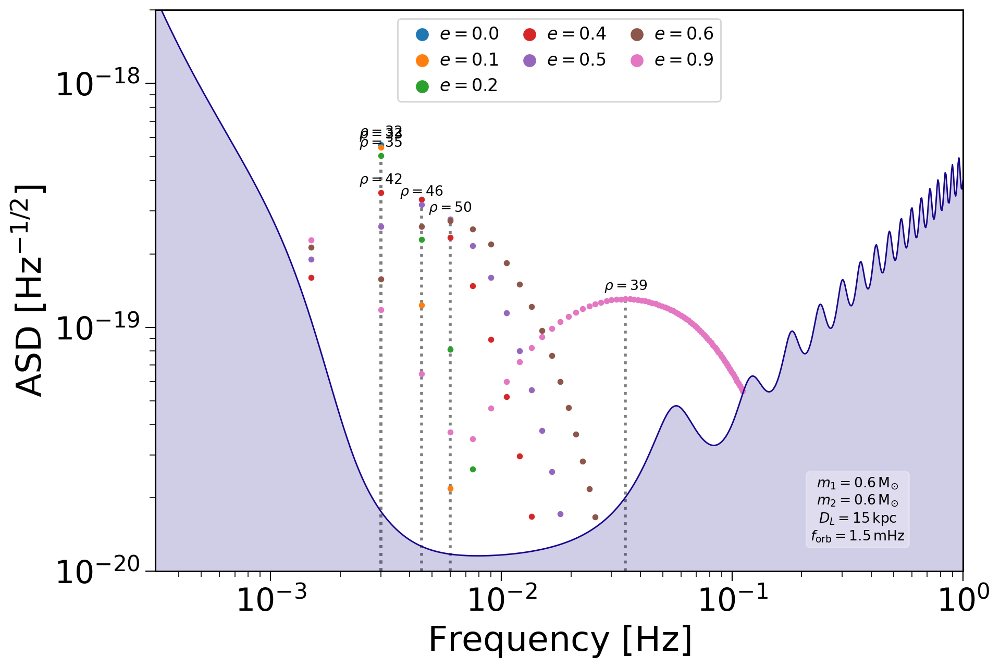

In [28]:
# plot LISA sensitivity curve
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False)

# plot each sources
#colours = [plt.get_cmap("plasma")(i) for i in [0.1, 0.5,0.6,0.7, 0.8,0.9]]
for i in range(len(snr2_n)):
    # work out the harmonic frequencies and ASDs
    f_harm = f_orb[i] * range(1, len(snr2_n[0]) + 1)
    y_vals = lw.psd.lisa_psd(f_harm)**(0.5) * np.sqrt(snr2_n)[i]

    # only plot points above the sensitivity curve
    mask = np.sqrt(snr2_n)[i] > 1.0

    # compute the index of the maximal SNR value
    max_index = np.argmax(y_vals[1:]) + 1

    # plot each harmonic
    ax.scatter(f_harm[mask], y_vals[mask],
               s=10,
               label=r"$e={{{:1.1f}}}$".format(ecc[i]))

    # annotate each source with its SNR at the max SNR value
    ax.annotate(r"$\rho={{{:1.0f}}}$".format(snr2_n[i].sum()**(0.5)),
                xy=(f_harm[max_index].value, y_vals[max_index].value * 1.05),
                ha="center", va="bottom", fontsize=0.4*fs)
    # plot a dotted line to highlight where the signal is concentrated
    ax.plot([f_harm[max_index].value] * 2, [1e-20, y_vals[max_index].value],
               color="grey", linestyle="dotted", lw=2, zorder=0)

# add a legend and annotate the other source properties
ax.legend(markerscale=2.5, handletextpad=0.0, ncol=3, loc="upper center",
          columnspacing=0.75, fontsize=0.5 * fs)

annotation_string = r"$m_1 = 0.6 \, {\rm M_{\odot}}$"
annotation_string += "\n"
annotation_string += r"$m_2 = 0.6 \, {\rm M_{\odot}}$"
annotation_string += "\n"
annotation_string += r"$D_L = 15 \, {\rm kpc}$"
annotation_string += "\n"
annotation_string += r"$f_{\rm orb} = 1.5 \, {\rm mHz}$"

ax.annotate(annotation_string, xy=(3.5e-1, 1.3e-20), ha="center", va="bottom", fontsize=0.4 * fs,
            bbox=dict(boxstyle="round", fc="white", ec="white", alpha=0.3))

ax.set_ylim(1e-20, 2e-18)

plt.show()

From this plot we observe binaries with higher eccentricity having more harmonics in a smaller range of frequency. 
- Binaries with higher eccentricity could be more decipher easily if a distinguishable pattern as shown in the plot is observed.  

## For a given Strain and Freq, plot the harmonics of the binary

In this exercise, similar to what we have done above, we plot the harmonics of the binary with varying frequency and eccentricity, keeping the chirp mass of the binary the same. 

In [29]:
import legwork.strain as strain

In [30]:
#Calculate characteristic strain
m_1 = np.repeat(0.6, 50) * u.Msun
m_2 = np.repeat(0.6,50) *u.Msun
f_orb = np.linspace(1e-3, 1e-2, 50) * u.Hz
dist = np.repeat(15, 50) * u.kpc
ecc = np.linspace(1e-6, 0.7, 50)
mc = lw.utils.chirp_mass(m_1,m_2)
n= np.arange(1,101,1)

In [31]:
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5) 

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/2635536384.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = get_cmap("plasma")
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found bec

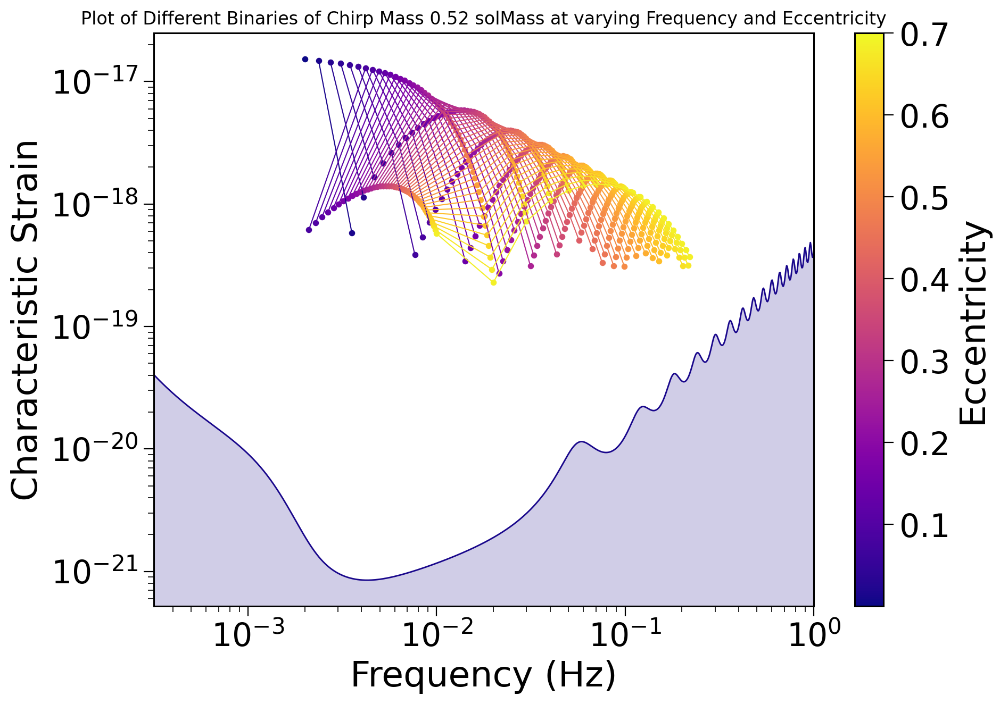

In [32]:
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False, y_quantity='h_c')
h_c_2 = strain.h_c_n(m_c = mc, f_orb = f_orb, ecc=ecc, dist = dist, n = n)
h_c_2 = h_c_2.reshape(50,100)
# Set up a color map and assign a unique color to each binary
colormap = get_cmap("plasma")
norm = Normalize(vmin=min(ecc), vmax=max(ecc))
colors = [colormap(i / len(snr2_n)) for i in range(len(snr2_n))]
scalar_map = ScalarMappable(norm=norm, cmap=colormap)
# Loop over each binary and plot its harmonics with consistent color
for i in range(len(snr2_n)):
    # Calculate harmonic frequencies
    f_harm = f_orb[i] * np.arange(1, len(snr2_n[0]) + 1)

    # Mask to plot only points above the sensitivity curve
    mask = np.sqrt(snr2_n[i]) > 1.0
    color = scalar_map.to_rgba(ecc[i])

    ax.scatter(f_harm[mask], h_c_2[i][mask], s=10, color=colors[i],
               label=f"Binary {i + 1}")
    ax.plot(f_harm[mask], h_c_2[i][mask], color=colors[i], linewidth=0.75)

#ax.legend(title="Binaries", loc="upper right", fontsize=8, markerscale=1.5)
cbar = plt.colorbar(scalar_map, ax=ax)
cbar.set_label("Eccentricity")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Characteristic Strain")
plt.title(f"Plot of Different Binaries of Chirp Mass {mc[0]:.2f} at varying Frequency and Eccentricity")
#plt.title("Harmonic Contributions for Each Binary at Fixed Eccentricity")
plt.show()

# m1 m2 = 1 Solmass

In [33]:
#Calculate characteristic strain
m_1 = np.repeat(1, 50) * u.Msun
m_2 = np.repeat(1,50) *u.Msun
f_orb = np.linspace(1e-3, 1e-2, 50) * u.Hz
dist = np.repeat(15, 50) * u.kpc
ecc = np.linspace(1e-6, 0.7, 50)
mc = lw.utils.chirp_mass(m_1,m_2)
n= np.arange(1,101,1)

In [34]:
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5) 

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/2635536384.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = get_cmap("plasma")
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found bec

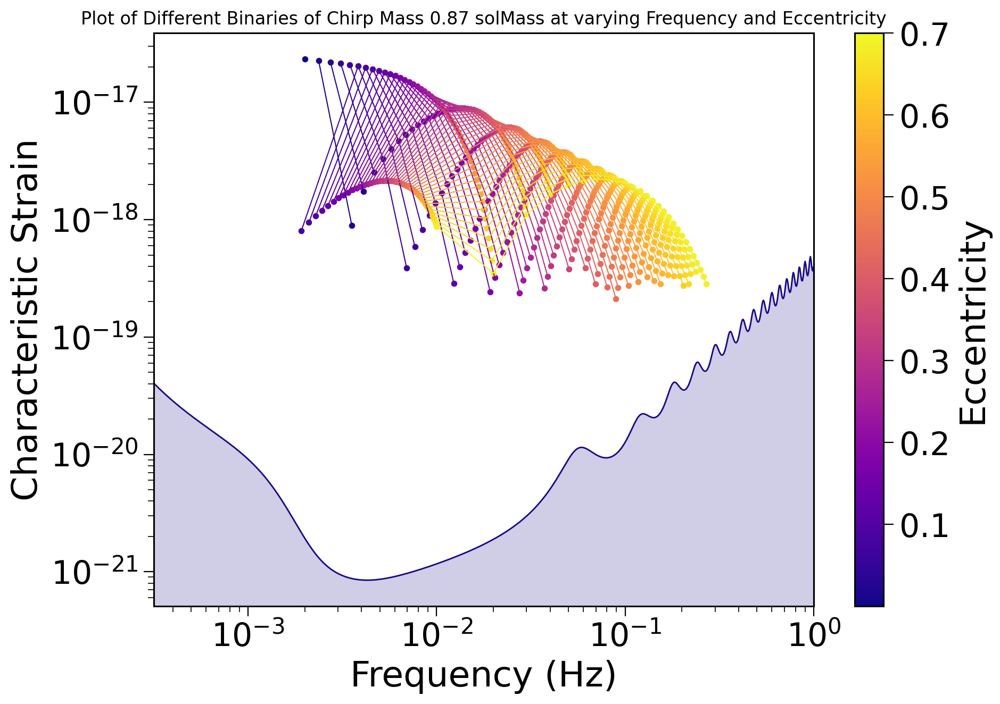

In [35]:
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False, y_quantity='h_c')
h_c_2 = strain.h_c_n(m_c = mc, f_orb = f_orb, ecc=ecc, dist = dist, n = n)
h_c_2 = h_c_2.reshape(50,100)
# Set up a color map and assign a unique color to each binary
colormap = get_cmap("plasma")
norm = Normalize(vmin=min(ecc), vmax=max(ecc))
colors = [colormap(i / len(snr2_n)) for i in range(len(snr2_n))]
scalar_map = ScalarMappable(norm=norm, cmap=colormap)
# Loop over each binary and plot its harmonics with consistent color
for i in range(len(snr2_n)):
    # Calculate harmonic frequencies
    f_harm = f_orb[i] * np.arange(1, len(snr2_n[0]) + 1)

    # Mask to plot only points above the sensitivity curve
    mask = np.sqrt(snr2_n[i]) > 1.0
    color = scalar_map.to_rgba(ecc[i])

    ax.scatter(f_harm[mask], h_c_2[i][mask], s=10, color=colors[i],
               label=f"Binary {i + 1}")
    ax.plot(f_harm[mask], h_c_2[i][mask], color=colors[i], linewidth=0.75)

#ax.legend(title="Binaries", loc="upper right", fontsize=8, markerscale=1.5)
cbar = plt.colorbar(scalar_map, ax=ax)
cbar.set_label("Eccentricity")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Characteristic Strain")
plt.title(f"Plot of Different Binaries of Chirp Mass {mc[0]:.2f} at varying Frequency and Eccentricity")
#plt.title("Harmonic Contributions for Each Binary at Fixed Eccentricity")
plt.show()

# m1 m2 = 10 solmass

In [36]:
#Calculate characteristic strain
m_1 = np.repeat(10, 50) * u.Msun
m_2 = np.repeat(10,50) *u.Msun
f_orb = np.linspace(1e-3, 1e-2, 50) * u.Hz
dist = np.repeat(15, 50) * u.kpc
ecc = np.linspace(1e-6, 0.7, 50)
mc = lw.utils.chirp_mass(m_1,m_2)
n= np.arange(1,101,1)

In [37]:
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5) 

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/2635536384.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = get_cmap("plasma")
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found bec

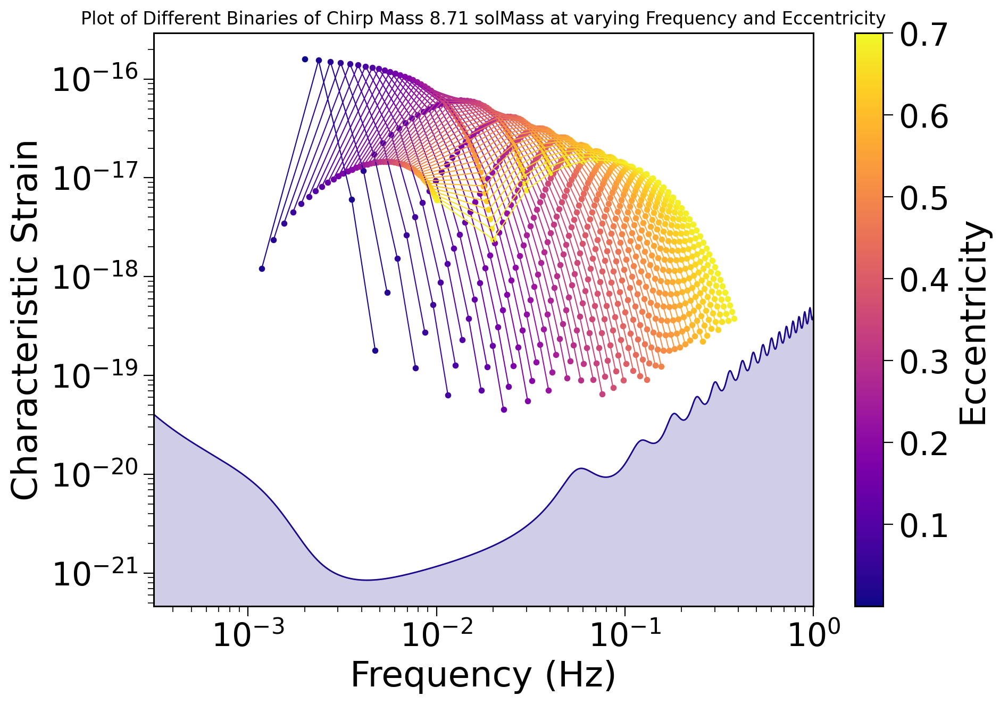

In [38]:
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False, y_quantity='h_c')
h_c_2 = strain.h_c_n(m_c = mc, f_orb = f_orb, ecc=ecc, dist = dist, n = n)
h_c_2 = h_c_2.reshape(50,100)
# Set up a color map and assign a unique color to each binary
colormap = get_cmap("plasma")
norm = Normalize(vmin=min(ecc), vmax=max(ecc))
colors = [colormap(i / len(snr2_n)) for i in range(len(snr2_n))]
scalar_map = ScalarMappable(norm=norm, cmap=colormap)
# Loop over each binary and plot its harmonics with consistent color
for i in range(len(snr2_n)):
    # Calculate harmonic frequencies
    f_harm = f_orb[i] * np.arange(1, len(snr2_n[0]) + 1)

    # Mask to plot only points above the sensitivity curve
    mask = np.sqrt(snr2_n[i]) > 1.0
    color = scalar_map.to_rgba(ecc[i])

    ax.scatter(f_harm[mask], h_c_2[i][mask], s=10, color=colors[i],
               label=f"Binary {i + 1}")
    ax.plot(f_harm[mask], h_c_2[i][mask], color=colors[i], linewidth=0.75)

#ax.legend(title="Binaries", loc="upper right", fontsize=8, markerscale=1.5)
cbar = plt.colorbar(scalar_map, ax=ax)
cbar.set_label("Eccentricity")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Characteristic Strain")
plt.title(f"Plot of Different Binaries of Chirp Mass {mc[0]:.2f} at varying Frequency and Eccentricity")
#plt.title("Harmonic Contributions for Each Binary at Fixed Eccentricity")
plt.show()

# NS + WD Chrip mass ~0.95 Solmass

In [39]:
#Calculate characteristic strain
m_1 = np.repeat(11, 50) * u.Msun
m_2 = np.repeat(11,50) *u.Msun
f_orb = np.linspace(1e-3, 1e-2, 50) * u.Hz
dist = np.repeat(15, 50) * u.kpc
ecc = np.linspace(1e-6, 0.7, 50)
mc = lw.utils.chirp_mass(m_1,m_2)
n= np.arange(1,101,1)

In [40]:
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5) 

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/2635536384.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = get_cmap("plasma")
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found bec

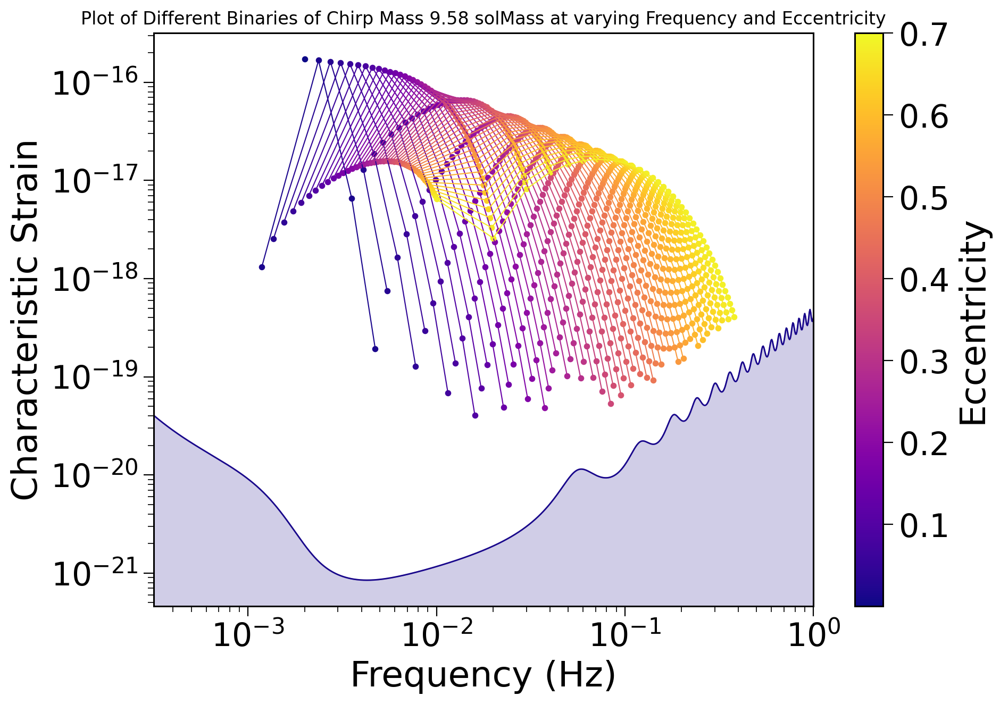

In [41]:
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False, y_quantity='h_c')
h_c_2 = strain.h_c_n(m_c = mc, f_orb = f_orb, ecc=ecc, dist = dist, n = n)
h_c_2 = h_c_2.reshape(50,100)
# Set up a color map and assign a unique color to each binary
colormap = get_cmap("plasma")
norm = Normalize(vmin=min(ecc), vmax=max(ecc))
colors = [colormap(i / len(snr2_n)) for i in range(len(snr2_n))]
scalar_map = ScalarMappable(norm=norm, cmap=colormap)
# Loop over each binary and plot its harmonics with consistent color
for i in range(len(snr2_n)):
    # Calculate harmonic frequencies
    f_harm = f_orb[i] * np.arange(1, len(snr2_n[0]) + 1)

    # Mask to plot only points above the sensitivity curve
    mask = np.sqrt(snr2_n[i]) > 1.0
    color = scalar_map.to_rgba(ecc[i])

    ax.scatter(f_harm[mask], h_c_2[i][mask], s=10, color=colors[i],
               label=f"Binary {i + 1}")
    ax.plot(f_harm[mask], h_c_2[i][mask], color=colors[i], linewidth=0.75)

#ax.legend(title="Binaries", loc="upper right", fontsize=8, markerscale=1.5)
cbar = plt.colorbar(scalar_map, ax=ax)
cbar.set_label("Eccentricity")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Characteristic Strain")
plt.title(f"Plot of Different Binaries of Chirp Mass {mc[0]:.2f} at varying Frequency and Eccentricity")
#plt.title("Harmonic Contributions for Each Binary at Fixed Eccentricity")
plt.show()

The 3 figures above show the how the plot evolves with varying chirp mass. 

# NS + WD ~1.1 Solmass

In [42]:
#Calculate characteristic strain
m_1 = np.repeat(13, 50) * u.Msun
m_2 = np.repeat(13,50) *u.Msun
f_orb = np.linspace(1e-3, 1e-2, 50) * u.Hz
dist = np.repeat(15, 50) * u.kpc
ecc = np.linspace(1e-6, 0.7, 50)
mc = lw.utils.chirp_mass(m_1,m_2)
n= np.arange(1,101,1)

In [43]:
snr2_n = lw.snr.snr_ecc_evolving(m_1=m_1, m_2=m_2, f_orb_i=f_orb, ecc=ecc, dist=dist,
                                 harmonics_required=100, t_obs=4 * u.yr, n_step=1000,
                                 ret_snr2_by_harmonic=True)

snr = snr2_n.sum(axis=1)**(0.5) 

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/2635536384.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = get_cmap("plasma")
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found bec

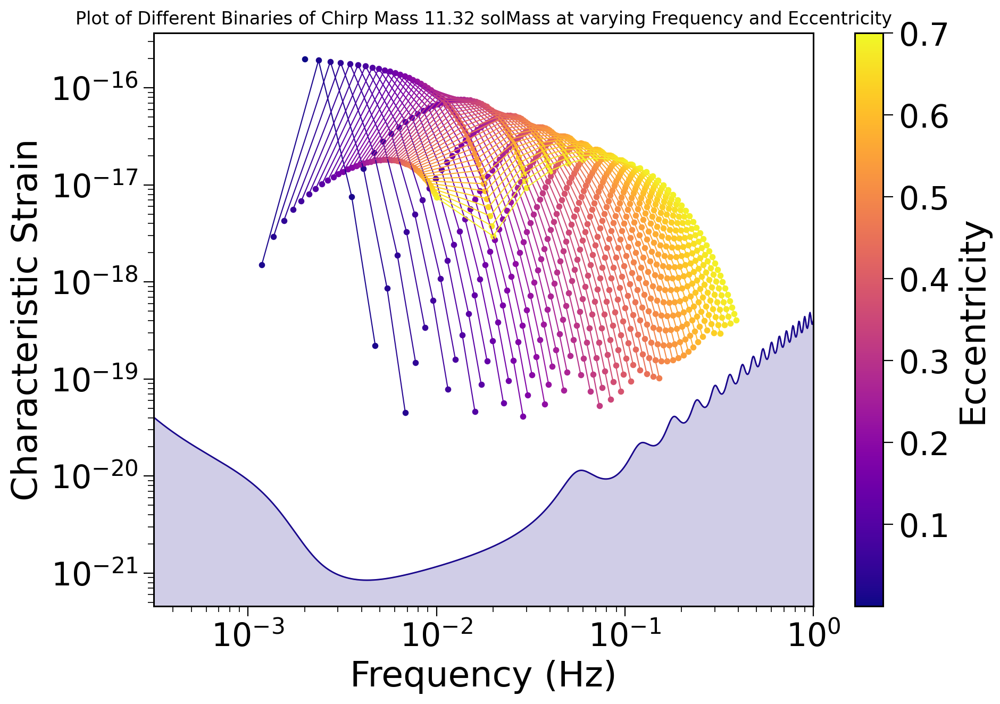

In [44]:
fig, ax = lw.visualisation.plot_sensitivity_curve(frequency_range=np.logspace(-3.5, 0, 1000) * u.Hz,
                                                  show=False, y_quantity='h_c')
h_c_2 = strain.h_c_n(m_c = mc, f_orb = f_orb, ecc=ecc, dist = dist, n = n)
h_c_2 = h_c_2.reshape(50,100)
# Set up a color map and assign a unique color to each binary
colormap = get_cmap("plasma")
norm = Normalize(vmin=min(ecc), vmax=max(ecc))
colors = [colormap(i / len(snr2_n)) for i in range(len(snr2_n))]
scalar_map = ScalarMappable(norm=norm, cmap=colormap)
# Loop over each binary and plot its harmonics with consistent color
for i in range(len(snr2_n)):
    # Calculate harmonic frequencies
    f_harm = f_orb[i] * np.arange(1, len(snr2_n[0]) + 1)

    # Mask to plot only points above the sensitivity curve
    mask = np.sqrt(snr2_n[i]) > 1.0
    color = scalar_map.to_rgba(ecc[i])

    ax.scatter(f_harm[mask], h_c_2[i][mask], s=10, color=colors[i],
               label=f"Binary {i + 1}")
    ax.plot(f_harm[mask], h_c_2[i][mask], color=colors[i], linewidth=0.75)

#ax.legend(title="Binaries", loc="upper right", fontsize=8, markerscale=1.5)
cbar = plt.colorbar(scalar_map, ax=ax)
cbar.set_label("Eccentricity")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Characteristic Strain")
plt.title(f"Plot of Different Binaries of Chirp Mass {mc[0]:.2f} at varying Frequency and Eccentricity")
#plt.title("Harmonic Contributions for Each Binary at Fixed Eccentricity")
plt.show()

We can look at frequency outside the LISA range as there might be other harmonics that could reach LISA sensitivity range. How eccentric the binary is or how much harmonics it needs.

## For different initial conditions, how long does it take for binary to circularized. 

/Users/irwin/opt/anaconda3/envs/legwork/lib/python3.11/site-packages/legwork/evol.py:401: ODEintWarning: Excess accuracy requested (tolerances too small). Run with full_output = 1 to get quantitative information.
  ecc_evol = np.array([odeint(de_dt, ecc_i[i], timesteps[i], args=(beta[i], c_0[i])).flatten()
/Users/irwin/opt/anaconda3/envs/legwork/lib/python3.11/site-packages/legwork/utils.py:225: RuntimeWarning: invalid value encountered in power
  a = c_0 * ecc**(12/19) / (1 - ecc**2) * (1 + (121/304) * ecc**2)**(870/2299)
/Users/irwin/opt/anaconda3/envs/legwork/lib/python3.11/site-packages/legwork/utils.py:225: RuntimeWarning: overflow encountered in square
  a = c_0 * ecc**(12/19) / (1 - ecc**2) * (1 + (121/304) * ecc**2)**(870/2299)
/Users/irwin/opt/anaconda3/envs/legwork/lib/python3.11/site-packages/astropy/units/quantity.py:671: RuntimeWarning: invalid value encountered in multiply
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/Users/irwin/opt/anaconda3/e

 lsoda--  at t (=r1), too much accuracy requested    
       for precision of machine..  see tolsf (=r2)   
      in above,  r1 =  0.1080169956946D+12   r2 =                  NaN
 lsoda--  at t (=r1), too much accuracy requested    
       for precision of machine..  see tolsf (=r2)   
      in above,  r1 =  0.1483685109856D+11   r2 =                  NaN
 lsoda--  at t (=r1), too much accuracy requested    
       for precision of machine..  see tolsf (=r2)   
      in above,  r1 =  0.9527919660755D+11   r2 =                  NaN
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t on the next step  
       (h = step size). solver will continue anyway  
      in above,  r1 =  0.1521869684621D+11   r2 =  0.4307866634385D-06
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t on the next step  
       (h = step size). solver will continue anyway  
      in above,  r1 =  0.1521869684621D+11   r2 =  0

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

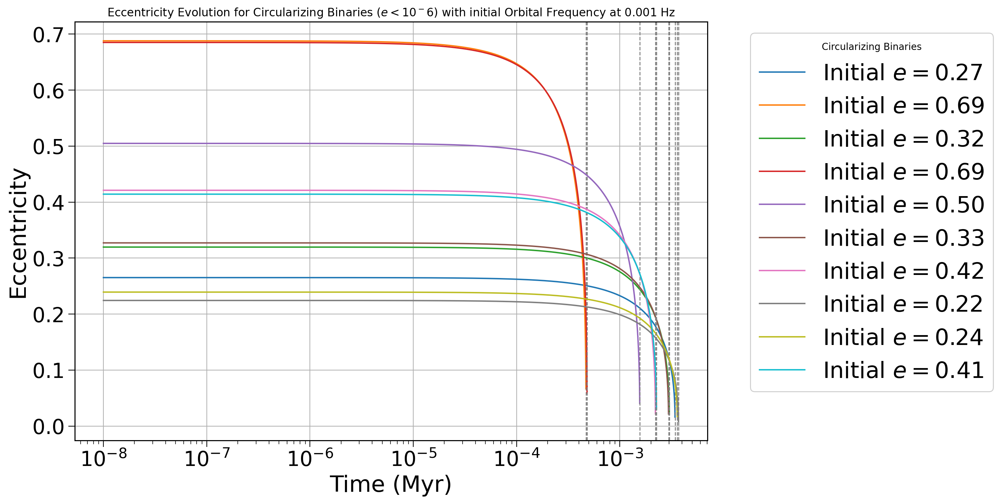

In [45]:
n_binaries = 10
m_1 = np.repeat(15, n_binaries) * u.Msun
m_2 = np.repeat(15, n_binaries) * u.Msun
f_orb_i = np.repeat(1e-3, n_binaries) * u.Hz #separate into two plots wider orbit or shorter orbit
ecc_i = np.random.uniform(0, 0.7, n_binaries) 

timesteps = (np.logspace(-2, 5, 10000) * u.yr).to(u.Myr)

# Calculate eccentricity evolution
ecc_evol, _ = lw.evol.evol_ecc(
    ecc_i=ecc_i, m_1=m_1, m_2=m_2, f_orb_i=f_orb_i,
    timesteps=timesteps, t_before=10 * u.yr, avoid_merger=False
)

# Define a threshold to consider circularization (near-zero eccentricity)
ecc_threshold = 1e-6
circularization_times = []

# Filter only circularizing binaries and record their circularization times
for i in range(n_binaries):
    if np.any(ecc_evol[i] < ecc_threshold):  # Check if binary circularizes
        threshold_index = np.where(ecc_evol[i] < ecc_threshold)[0][0]
        time_to_circularize = timesteps[threshold_index]
        circularization_times.append((i, threshold_index, time_to_circularize))  # Store index, threshold index, and time

# Plot eccentricity evolution for only the circularizing binaries
fig, ax = plt.subplots()

for i, threshold_index, circ_time in circularization_times:
    # Plot up to just before reaching the threshold
    ax.plot(
        timesteps[:threshold_index].value, ecc_evol[i][:threshold_index], lw=1.5,
        label=f"Initial $e={ecc_i[i]:.2f}$"
    )
    # Add a vertical line indicating the circularization time
    ax.axvline(circ_time.value, color='gray', linestyle='--', lw=1)

# Set plot labels and log scale for better visualization
ax.set_xlabel("Time (Myr)")
ax.set_ylabel("Eccentricity")
#ax.set_yscale("log")
ax.set_xscale('log')
ax.legend(title="Circularizing Binaries", loc="upper left", bbox_to_anchor=(1.05, 1), framealpha=0.95)
plt.title(f"Eccentricity Evolution for Circularizing Binaries ($e < 10^{-6}$) with initial Orbital Frequency at {f_orb_i[0]}")
plt.grid(True)
plt.show()

 lsoda--  at t (=r1), too much accuracy requested    
       for precision of machine..  see tolsf (=r2)   
      in above,  r1 =  0.3168609058621D+06   r2 =                  NaN
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t on the next step  
       (h = step size). solver will continue anyway  
      in above,  r1 =  0.3162495556010D+06   r2 =  0.2537810029799D-10
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t on the next step  
       (h = step size). solver will continue anyway  
      in above,  r1 =  0.3162495556010D+06   r2 =  0.2537810029799D-10
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t on the next step  
       (h = step size). solver will continue anyway  
      in above,  r1 =  0.3162495556010D+06   r2 =  0.2537810029799D-10
 lsoda--  warning..internal t (=r1) and h (=r2) are  
       such that in the machine, t + h = t o

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

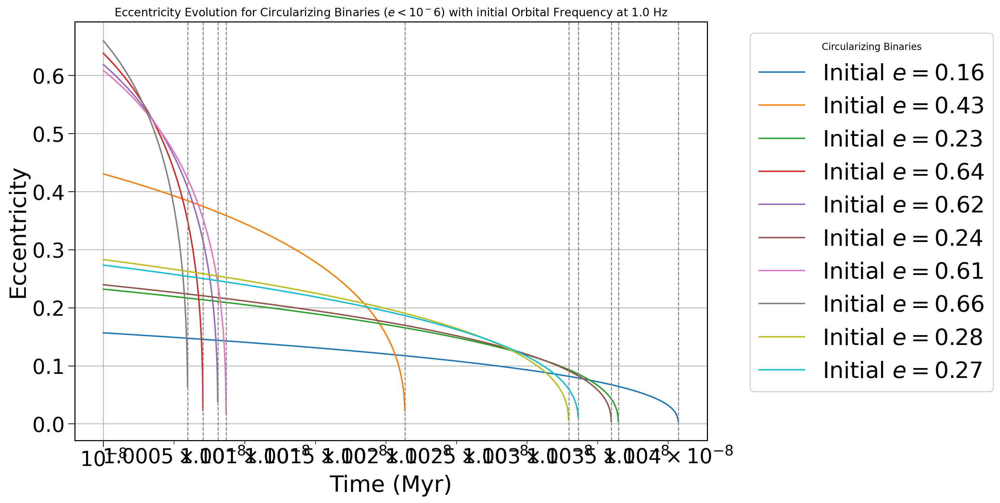

In [46]:
n_binaries = 10
m_1 = np.repeat(15, n_binaries) * u.Msun
m_2 = np.repeat(15, n_binaries) * u.Msun
f_orb_i = np.repeat(1e0, n_binaries) * u.Hz #separate into two plots wider orbit or shorter orbit
ecc_i = np.random.uniform(0, 0.7, n_binaries) 

timesteps = (np.logspace(-2, 3, 10000000) * u.yr).to(u.Myr)

# Calculate eccentricity evolution
ecc_evol, _ = lw.evol.evol_ecc(
    ecc_i=ecc_i, m_1=m_1, m_2=m_2, f_orb_i=f_orb_i,
    timesteps=timesteps, t_before=10 * u.yr, avoid_merger=False
)

# Define a threshold to consider circularization (near-zero eccentricity)
ecc_threshold = 1e-6
circularization_times = []

# Filter only circularizing binaries and record their circularization times
for i in range(n_binaries):
    if np.any(ecc_evol[i] < ecc_threshold):  # Check if binary circularizes
        threshold_index = np.where(ecc_evol[i] < ecc_threshold)[0][0]
        time_to_circularize = timesteps[threshold_index]
        circularization_times.append((i, threshold_index, time_to_circularize))  # Store index, threshold index, and time

# Plot eccentricity evolution for only the circularizing binaries
fig, ax = plt.subplots()

for i, threshold_index, circ_time in circularization_times:
    # Plot up to just before reaching the threshold
    ax.plot(
        timesteps[:threshold_index].value, ecc_evol[i][:threshold_index], lw=1.5,
        label=f"Initial $e={ecc_i[i]:.2f}$"
    )
    # Add a vertical line indicating the circularization time
    ax.axvline(circ_time.value, color='gray', linestyle='--', lw=1)

# Set plot labels and log scale for better visualization
ax.set_xlabel("Time (Myr)")
ax.set_ylabel("Eccentricity")
#ax.set_yscale("log")
ax.set_xscale('log')
ax.legend(title="Circularizing Binaries", loc="upper left", bbox_to_anchor=(1.05, 1), framealpha=0.95)
plt.title(f"Eccentricity Evolution for Circularizing Binaries ($e < 10^{-6}$) with initial Orbital Frequency at {f_orb_i[0]}")
plt.grid(True)
plt.show()

## Corner plot

In [47]:
with open('/Users/irwin/Documents/GitHub/lisa-ml/data/fims_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.pkl', 'rb') as filehandle:
    data = pickle.load(filehandle)

In [48]:
data['parameter names']

['Frequency_mHz',
 'FrequencyDerivative_log10',
 'EclipticLatitude_sin',
 'EclipticLongitude',
 'Amplitude_log10',
 'Inclination_cos',
 'Polarization',
 'InitialPhase']

In [49]:
data.keys()

dict_keys(['MW_DWD 0', 'MW_DWD 305', 'MW_DWD 336', 'MW_DWD 343', 'MW_DWD 345', 'MW_DWD 348', 'MW_DWD 349', 'MW_DWD 351', 'MW_DWD 353', 'MW_DWD 354', 'MW_DWD 355', 'MW_DWD 356', 'MW_DWD 357', 'MW_DWD 358', 'MW_DWD 359', 'MW_DWD 360', 'MW_DWD 361', 'MW_DWD 423', 'MW_DWD 425', 'MW_DWD 479', 'MW_DWD 481', 'MW_DWD 482', 'MW_DWD 483', 'MW_DWD 484', 'MW_DWD 604', 'MW_DWD 605', 'MW_DWD 616', 'MW_DWD 617', 'MW_DWD 997', 'MW_DWD 1002', 'MW_DWD 1003', 'MW_DWD 1004', 'MW_DWD 1095', 'MW_DWD 1097', 'MW_DWD 1113', 'MW_DWD 1114', 'MW_DWD 1115', 'MW_DWD 1286', 'MW_DWD 1287', 'MW_DWD 1289', 'MW_DWD 1292', 'MW_DWD 1311', 'MW_DWD 1312', 'MW_DWD 1315', 'MW_DWD 1316', 'MW_DWD 1317', 'MW_DWD 1355', 'MW_DWD 1357', 'MW_DWD 1358', 'MW_DWD 1359', 'MW_DWD 1360', 'MW_DWD 1380', 'MW_DWD 1388', 'MW_DWD 1520', 'MW_DWD 1522', 'MW_DWD 1523', 'MW_DWD 1639', 'MW_DWD 1652', 'MW_DWD 1653', 'MW_DWD 1654', 'MW_DWD 1655', 'MW_DWD 1656', 'MW_DWD 1657', 'MW_DWD 1658', 'MW_DWD 1659', 'MW_DWD 1660', 'MW_DWD 1661', 'MW_DWD 1662', 

In [50]:
snr_1.shape

(971,)

In [51]:
data['MW_DWD 0'].shape

(8, 8)

In [52]:
cats, units = h5io.load_array('/Users/irwin/Documents/GitHub/lisa-ml/data/resolved_Model2_1_MW_DWDs_aa2CE_NSWDs_aa2CE_vkick.h5', 'cat')
                              #(cat_path + 'resolved_' + cat_name_1 + '.h5', 'cat') #resolved_DWDs_NSWDs_MW_test_tot_pow_NEW.h5'
names_1 = cats['Name']
f0_1    = cats['Frequency'] # Extract the parameters
Amp0_1  = cats['Amplitude']
fdot0_1 = cats['FrequencyDerivative']
snr_1 = np.sqrt(cats['snr2'])
fconf = data_1['f']     # The frequency array of the data
ecc_1 = cats['Eccentricity']
incl_1 = cats['Inclination']
pol_1 = cats['Polarization']
elplang_1 = cats['EclipticLatitude']
elplong_1 = cats['EclipticLongitude']
iniphase_1 = cats['InitialPhase']

In [53]:
print(np.argmin(snr_1))
print(np.argmax(snr_1))
print(np.argmin(f0_1))
print(np.argmax(f0_1))

966
944
954
520


In [54]:
from matplotlib.ticker import ScalarFormatter
def fisher_corner_plot(data, ID, index):
    parameter_names = [
    'Frequency_mHz',
    'FrequencyDerivative_log10',
    'EclipticLatitude_sin',
    'EclipticLongitude',
    'Amplitude_log10',
    'Inclination_cos',
    'Polarization',
    'InitialPhase'
    ]
    mean = [f0_1[index]*1e3, np.log10(fdot0_1[index] * 1e6), np.sin(elplang_1[index]), elplong_1[index], np.log10(Amp0_1[index]), np.cos(incl_1[index]), pol_1[index], iniphase_1[index]]
    covariance_matrix = np.linalg.inv(data[ID])

    samples = np.random.multivariate_normal(mean, covariance_matrix, size=100000)
    fig = corner.corner(
    samples,
    labels=parameter_names,
    quantiles=[0.16, 0.5, 0.84],
    show_titles=False,
    title_fmt=".2f",
    label_kwargs={"fontsize": 12, "wrap": True},
    truths=mean,
    title_kwargs={"fontsize": 10, "wrap": True}
    )
    for ax in fig.get_axes():
        plt.setp(ax.get_xticklabels(), fontsize=10)  
        plt.setp(ax.get_yticklabels(), fontsize=10) 
        
    for ax in fig.get_axes():
        ax.xaxis.get_offset_text().set_fontsize(10)
        ax.yaxis.get_offset_text().set_fontsize(10)
    axes = np.array(fig.axes).reshape(len(parameter_names), len(parameter_names))
    for i, ax in enumerate(axes.diagonal()):
        # Custom wrapped title
        title_text = f"{parameter_names[i]} \n= {mean[i]:.2e}"
        wrapped_text = "\n".join(textwrap.wrap(title_text, width=20))  # Adjust width as needed
        ax.set_title(wrapped_text, fontsize=12)     
    plt.suptitle(f"Parameter Uncertainties and Confidence Ellipses for Binary {ID}", fontsize=14)
    plt.show()

# Low SNR

Correct the means using the catalouge

In [55]:
f0_1[966]

0.0013769398052588

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/950109936.py:16: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  samples = np.random.multivariate_normal(mean, covariance_matrix, size=100000)
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because

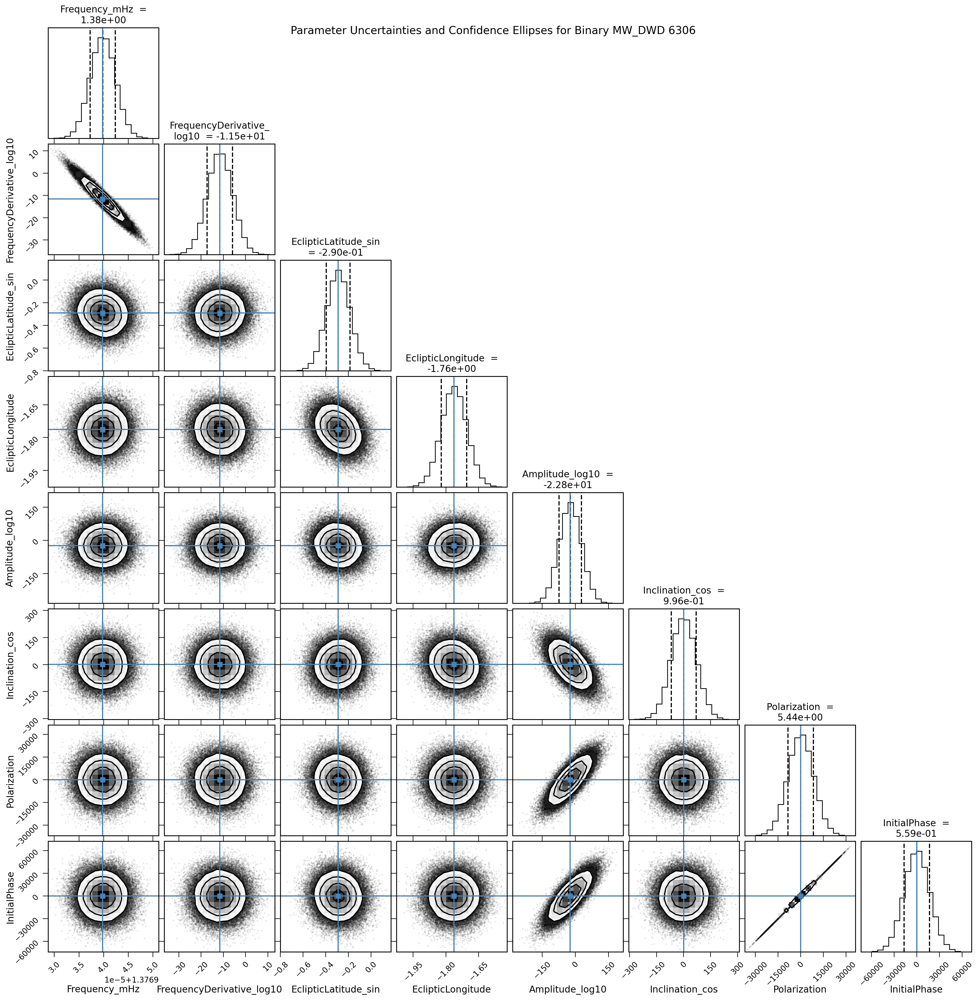

In [56]:
fisher_corner_plot(data, names_1[np.argmin(snr_1)], np.argmin(snr_1))

Amplitude and need to account for how long LISA observe the binary. Account for how many orbits the binary make during LISA's mission timeline. Amp x sqrt(obs_time (s) x Binary Freq) Signal integrated over 4 years. SNR 7 is the minimum. 

# High SNR

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

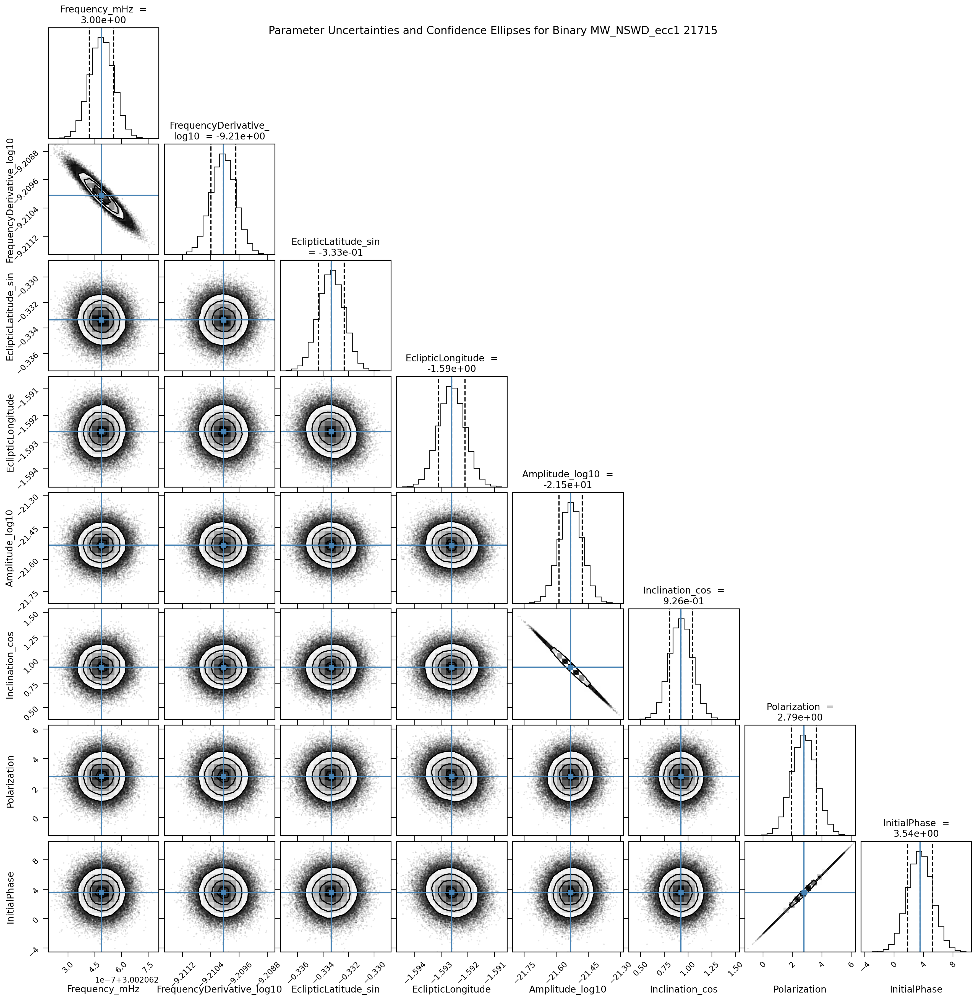

In [57]:
fisher_corner_plot(data, names_1[np.argmax(snr_1)], np.argmax(snr_1))

# Low F

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

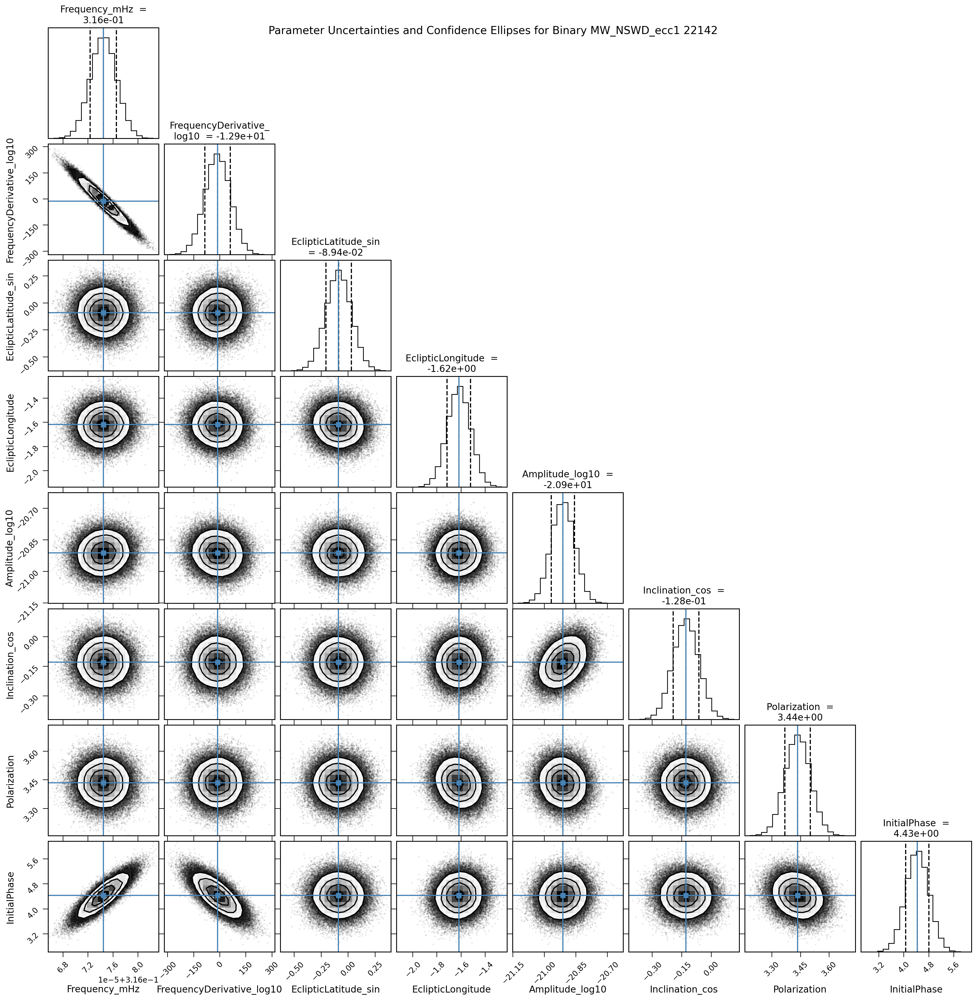

In [58]:
fisher_corner_plot(data, names_1[np.argmin(f0_1)], np.argmin(f0_1))

# High F

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

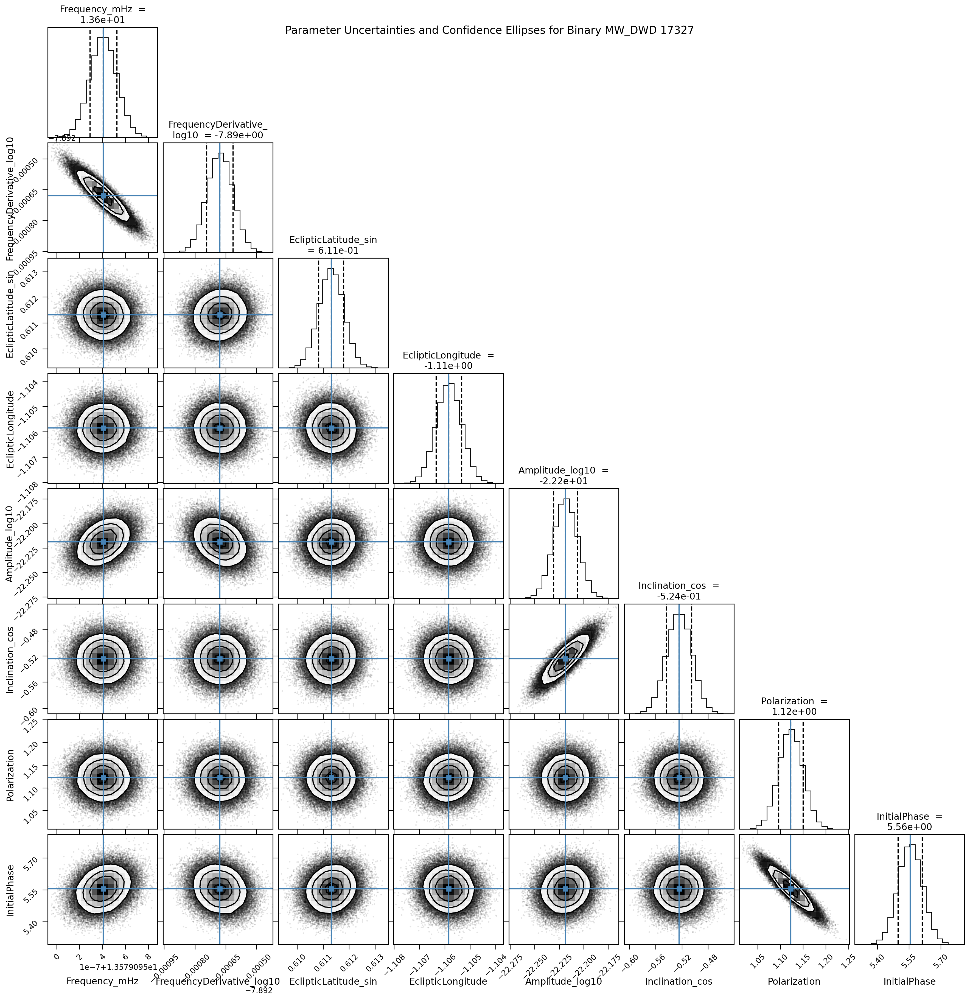

In [59]:
fisher_corner_plot(data, names_1[np.argmax(f0_1)], np.argmax(f0_1))

True values are at the catalouge fix the corner plots, highlight the true values for the corner plots

Using the diagonals of FIM (for now, in the future we can explore the correlations),
Amplitude freq plot we use the FIM plot the error bars. Each point is a binary. 
Frequency derivative vs ____ and plot the error bars. (Look into some cases)
Look at the error bar distribution. 
Use this information we can translate it into some probability maps. 



In [60]:
data[names_1[0]][7,7]

1679.41332414095

In [61]:
names_1[0]

'MW_DWD 0'

In [62]:
np.log10(Amp0_1[0])

-22.392715959269488

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

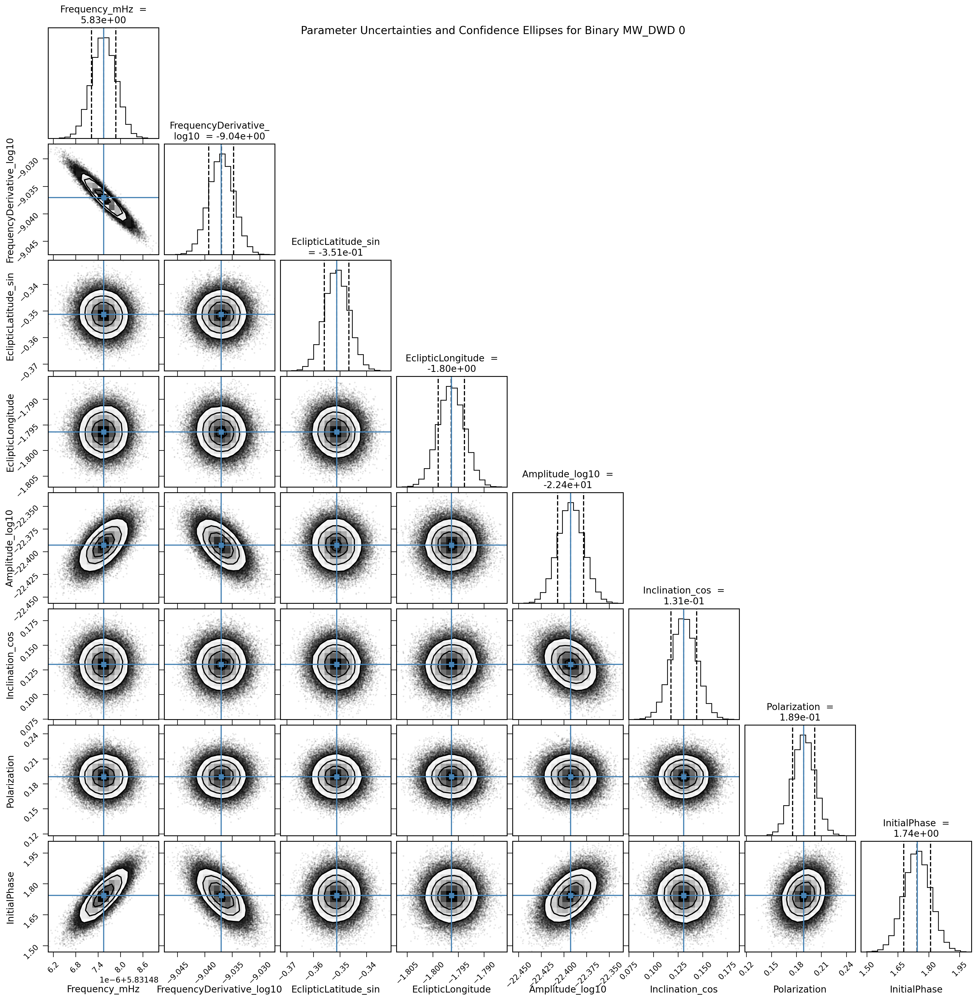

In [63]:
fisher_corner_plot(data, names_1[0], 0)

# Creating Dataframe

In [136]:
import pandas as pd
data_3 = []
for binary_name, fisher_matrix in data.items():
    if binary_name != 'parameter names':
        covariance_matrix = np.linalg.inv(fisher_matrix)
        data_3.append({
            "Binary": binary_name,
            "Frequency_mHz_error": 1.52 * np.sqrt(covariance_matrix[0, 0]),
            "FrequencyDerivative_log10_error": 1.52 * np.sqrt(covariance_matrix[1,1]),
            "sigma_f_fdot": covariance_matrix[0, 1],
            "sigma_amp_f" : covariance_matrix[0,4],
            "Amplitude_log10_error": 1.52 * np.sqrt(covariance_matrix[4, 4])
    })
df = pd.DataFrame(data_3)

In [137]:
binary_mapping = {}
for index, name in enumerate(names_1):
    if name not in binary_mapping:
        binary_mapping[name] = {
            "Amplitude_log10": np.log10(Amp0_1[index]),
            "Frequency_mHz": f0_1[index] * 1e3,
            "FrequencyDerivative_log10": np.log10(fdot0_1[index] * (1e6)),
            "Eccentricity": ecc_1[index],
            "ChirpMass_SolarMass": Mchirp[index]
        }

df['Amplitude_log10'] = df['Binary'].map(lambda x: binary_mapping.get(x, {}).get("Amplitude_log10", np.nan))
df['Frequency_mHz'] = df['Binary'].map(lambda x: binary_mapping.get(x, {}).get("Frequency_mHz", np.nan))
df['FrequencyDerivative_log10'] = df['Binary'].map(lambda x: binary_mapping.get(x, {}).get("FrequencyDerivative_log10", np.nan))
df["Eccentricity"] = df['Binary'].map(lambda x: binary_mapping.get(x, {}).get("Eccentricity", np.nan))
df['ChirpMass_SolarMass'] =  df['Binary'].map(lambda x: binary_mapping.get(x, {}).get("ChirpMass_SolarMass", np.nan))

In [138]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708
...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635


In [ ]:
def find_duplicate_names(names):
    seen = set()
    duplicates = set()
    for name in names:
        if name in seen:
            duplicates.add(name)
        else:
            seen.add(name)
    return list(duplicates)

find_duplicate_names(names_1)

['MW_NSWD_ecc1 20720',
 'MW_NSWD_ecc1 22142',
 'MW_NSWD_ecc1 18593',
 'MW_NSWD_ecc1 4471',
 'MW_NSWD_ecc1 19667',
 'MW_NSWD_ecc1 6948',
 'MW_NSWD_ecc1 20631',
 'MW_NSWD_ecc1 20699',
 'MW_NSWD_ecc1 17723',
 'MW_NSWD_ecc1 18220',
 'MW_NSWD_ecc1 18032',
 'MW_NSWD_ecc1 20488',
 'MW_NSWD_ecc1 3059',
 'MW_NSWD_ecc1 19577',
 'MW_NSWD_ecc1 20923',
 'MW_NSWD_ecc1 22574',
 'MW_NSWD_ecc1 16322',
 'MW_NSWD_ecc1 21789',
 'MW_NSWD_ecc1 18635',
 'MW_NSWD_ecc1 21522',
 'MW_NSWD_ecc1 21715',
 'MW_NSWD_ecc1 15373',
 'MW_NSWD_ecc1 22591',
 'MW_NSWD_ecc1 21564',
 'MW_NSWD_ecc1 7466',
 'MW_NSWD_ecc1 16232',
 'MW_NSWD_ecc1 20001',
 'MW_NSWD_ecc1 14320',
 'MW_NSWD_ecc1 18036',
 'MW_NSWD_ecc1 9435']

eccentricity -> contains different harmonics. Can try plotting out the maximum of the duplicate. 

In [ ]:
names_1[np.argmax(snr_1)]

'MW_NSWD_ecc1 21715'

In [152]:
import plotly.express as px

def plot_fisher_relation_interactive(df):
    """
    Creates an interactive plot of amplitude vs frequency for binaries,
    with colors indicating their class (DWD or NSWD).
    """
    fig = px.scatter(
        df,
        x="Frequency_mHz",
        y="Amplitude_log10",
        error_x="Frequency_mHz_error",
        error_y="Amplitude_log10_error",
        hover_name="Binary",
        color="class",  # Differentiating by class with distinct colors
        title="Amplitude vs Frequency with Error Bars"
    )
    fig.update_traces(marker=dict(size=8, opacity=0.7))
    fig.update_layout(
        xaxis_range=[2, 10], 
        yaxis_range=[-30, -20],    
        title="Amplitude vs Frequency by Class",
    )

    fig.show()



In [70]:
import plotly.graph_objects as go
def plot_fisher_relation_heatmap(df):
    """
    Creates an interactive heatmap of amplitude vs frequency for binaries, differentiated by class.
    """
    fig = go.Figure()

    # Filter data for each class
    for class_type, color in zip(['DWD', 'NSWD'], ['Viridis', 'Plasma']):
        class_df = df[df['class'] == class_type]
        fig.add_trace(
            go.Histogram2d(
                x=class_df['Frequency_mHz'],
                y=class_df['Amplitude_log10'],
                nbinsx=100,
                nbinsy=100,
                colorscale=color,
                showscale=False,
                opacity=0.6,
                name=f"{class_type} Heatmap"
            )
        )

    fig.update_layout(
        title="Density Heatmap: Amplitude vs Frequency by Class",
        xaxis_title="Frequency (mHz)",
        yaxis_title="Amplitude (log10)",
        barmode="overlay"
    )
    fig.show()


In [71]:
import plotly.express as px

def plot_fisher_relation_heatmap_side_by_side(df):
    """
    Creates side-by-side interactive heatmaps for amplitude vs frequency for binaries, differentiated by class.
    """
    fig = px.density_heatmap(
        df, 
        x='Frequency_mHz', 
        y='Amplitude_log10', 
        facet_col='class',  # Create facets for each class
        nbinsx=100, 
        nbinsy=100, 
        color_continuous_scale='Viridis'
    )
    fig.update_layout(
        title="Density Heatmap: Amplitude vs Frequency by Class",
        xaxis_title="Frequency (mHz)",
        yaxis_title="Amplitude (log10)"
    )
    fig.show()

In [72]:
import plotly.express as px

def plot_fisher_relation_contour_side_by_side(df):
    """
    Creates side-by-side interactive contour plots for amplitude vs frequency for binaries, differentiated by class.
    """
    fig = px.density_contour(
        df,
        x='Frequency_mHz',
        y='Amplitude_log10',
        facet_col='class',  # Create facets for each class
    )
    fig.update_layout(
        title="Density Contour: Amplitude vs Frequency by Class",
        xaxis_title="Frequency (mHz)",
        yaxis_title="Amplitude (log10)"
    )
    fig.show()

In [73]:
import plotly.graph_objects as go

def plot_fisher_relation_contour_overlap(df):
    """
    Creates overlapping contour plots for amplitude vs frequency for binaries, differentiated by class, with distinct colors.
    """
    # Filter data by class
    dwd_data = df[df['class'] == 'DWD']
    nswd_data = df[df['class'] == 'NSWD']

    # Create the plot
    fig = go.Figure()

    # Add contour for DWD
    fig.add_trace(go.Contour(
        x=dwd_data['Frequency_mHz'],
        y=dwd_data['Amplitude_log10'],
        z=[1] * len(dwd_data),  # Dummy variable for contours
        colorscale='Blues',
        contours=dict(showlabels=False),
        name='DWD'
    ))

    # Add contour for NSWD
    fig.add_trace(go.Contour(
        x=nswd_data['Frequency_mHz'],
        y=nswd_data['Amplitude_log10'],
        z=[1] * len(nswd_data),  # Dummy variable for contours
        colorscale='Reds',
        contours=dict(showlabels=False),
        name='NSWD'
    ))

    # Update layout
    fig.update_layout(
        title="Overlapping Contours: Amplitude vs Frequency by Class",
        xaxis_title="Frequency (mHz)",
        yaxis_title="Amplitude (log10)",
        showlegend=True
    )

    fig.show()

In [74]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

def plot_fisher_relation_contour_overlap(df):
    """
    Creates overlapping contour plots for amplitude vs frequency for binaries,
    showing the overlap region between classes.
    """
    # Filter data by class
    dwd_data = df[df['class'] == 'DWD']
    nswd_data = df[df['class'] == 'NSWD']

    # Extract frequency and amplitude for each class
    dwd_x, dwd_y = dwd_data['Frequency_mHz'], dwd_data['Amplitude_log10']
    nswd_x, nswd_y = nswd_data['Frequency_mHz'], nswd_data['Amplitude_log10']

    # Create density estimators
    dwd_kde = gaussian_kde([dwd_x, dwd_y])
    nswd_kde = gaussian_kde([nswd_x, nswd_y])

    # Define grid for evaluation
    x_min, x_max = min(df['Frequency_mHz']), max(df['Frequency_mHz'])
    y_min, y_max = min(df['Amplitude_log10']), max(df['Amplitude_log10'])
    x, y = np.linspace(x_min, x_max, 500), np.linspace(y_min, y_max, 500)
    xx, yy = np.meshgrid(x, y)

    # Evaluate KDEs on the grid
    dwd_density = dwd_kde(np.vstack([xx.ravel(), yy.ravel()])).reshape(xx.shape)
    nswd_density = nswd_kde(np.vstack([xx.ravel(), yy.ravel()])).reshape(xx.shape)

    # Create the plot
    plt.figure(figsize=(10, 8))

    # Contour for DWD
    plt.contourf(xx, yy, dwd_density, levels=50, alpha=0.6, cmap='Blues', label="DWD Density")
    plt.colorbar(label="DWD Density", pad=0.1)

    # Contour for NSWD
    plt.contourf(xx, yy, nswd_density, levels=50, alpha=0.6, cmap='Reds', label="NSWD Density")
    plt.colorbar(label="NSWD Density", pad=0.1)

    # # Contour for overlap
    # overlap_density = np.minimum(dwd_density, nswd_density)
    # plt.contour(xx, yy, overlap_density, levels=10, colors='purple', linewidths=1.5, label="Overlap Region")
    
    # Labels and title
    plt.title("Overlapping Contour Plot: Amplitude vs Frequency by Class", fontsize=14)
    plt.xlabel("Frequency (mHz)", fontsize=12)
    plt.ylabel("Amplitude (log10)", fontsize=12)
    #plt.legend(["DWD", "NSWD", "Overlap"], loc="upper right")

    #plt.grid(alpha=0.3)
    plt.show()

In [ ]:
filtered = df[df['Binary'] == 'MW_DWD 1934']

In [ ]:
filtered

,Binary,Frequency_mHz_error,Amplitude_log10_error,Amplitude_log10,Frequency_mHz
81,MW_DWD 1934,0.000004,1491.055183,-22.536055,1.059252


In [ ]:
for c, i in enumerate(names_1):
    if i  == 'MW_DWD 1934':
        print(c)
    

81


In [ ]:
snr_1[81]

7.592719986109983

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_64189/3908175403.py:16: RuntimeWarning:

covariance is not symmetric positive-semidefinite.



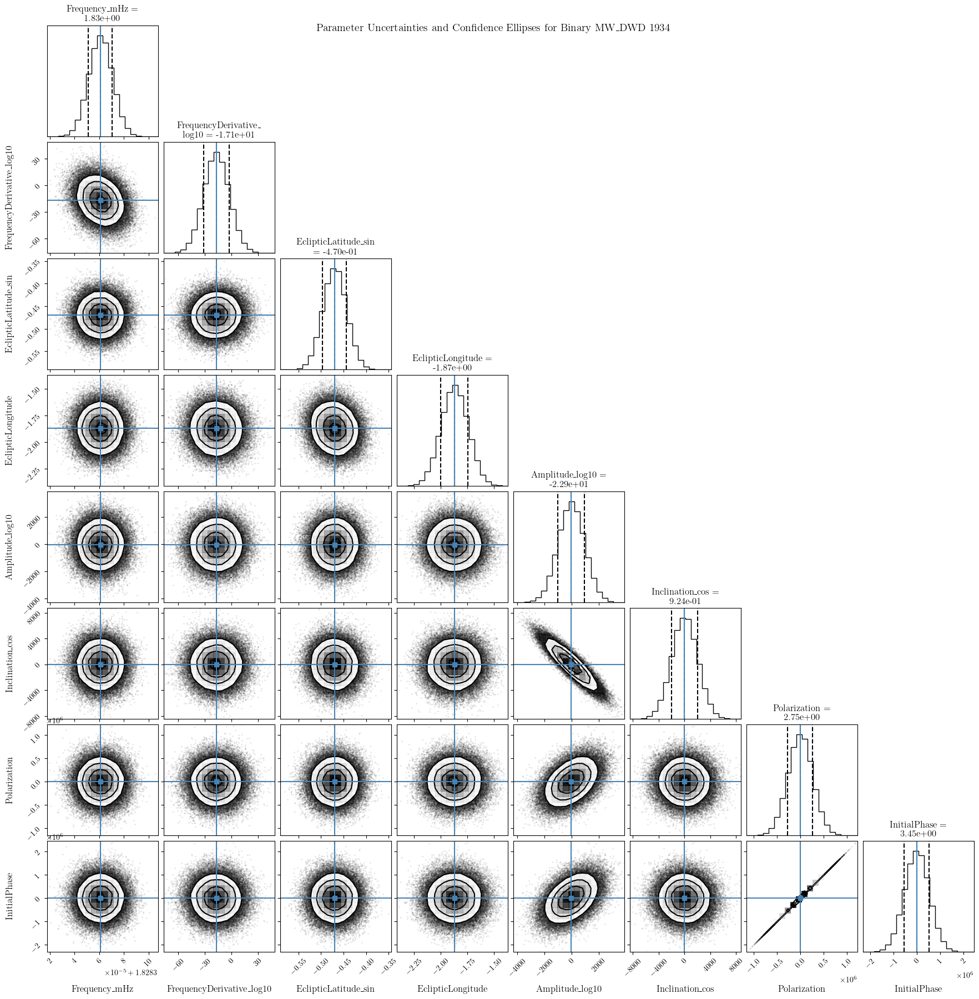

In [ ]:
fisher_corner_plot(data, 'MW_DWD 1934', 84)

In [153]:
plot_fisher_relation_interactive(df)

Amplitude Error scales 1/SNR 
Obtain SNR more than 50 for this plot to be more readable. 
Colour code the WDWD, NSWD
Include the non-diagonal cases for contour binary cases. 


$A \propto \frac{f^{2/3}M^{5/3}}{d}$

$A = \frac{5}{96\pi^2} \frac{\dot{f}}{f^3 d}$

$\sigma_d \propto (pd/pf)^2 \sigma_f^2 + (pd/p\dot{f})^2 \sigma_{\dot{f}}^2 + (pd/pA)^2 \sigma_d^2 + 2(pd/pf)(pd/p\dot{f}) \sigma_{f\dot{f}} + 2(pd/p\dot{f})(pd/pA) \sigma_{\dot{f}A}$

f and fdot contour [not the contour]

sky position ecliptic longtitude and latitude

plot chirp mass and freq [x]

plot heat maps/kernel density plots of A and F and later assign a propbability to it [x]

can start looking different catalouges 

look into the binsize to see a pattern

plot and some sort of functions that will give you the number to put in the thesis


In [341]:
plot_fisher_relation_heatmap(df)

In [344]:
plot_fisher_relation_heatmap_side_by_side(df)

In [351]:
plot_fisher_relation_contour_side_by_side(df)

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_64189/484152247.py:36: UserWarning:

The following kwargs were not used by contour: 'label'

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_64189/484152247.py:40: UserWarning:

The following kwargs were not used by contour: 'label'



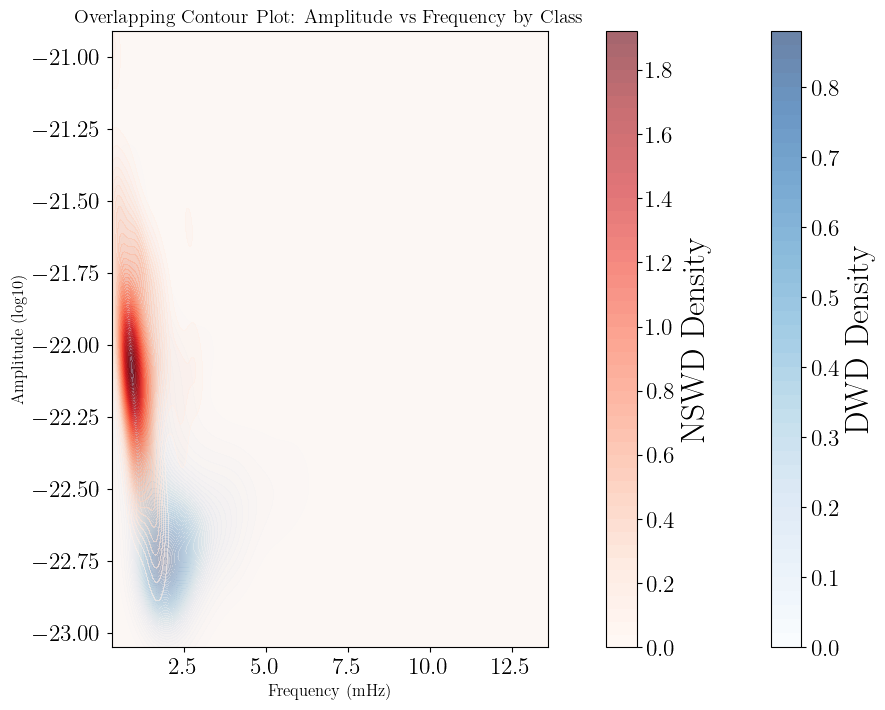

In [359]:
plot_fisher_relation_contour_overlap(df)

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/484152247.py:36: UserWarning:

The following kwargs were not used by contour: 'label'

/var/folders/rm/5j_dp79x6xx6xmxlxxs9k4y80000gn/T/ipykernel_20258/484152247.py:40: UserWarning:

The following kwargs were not used by contour: 'label'

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following famil

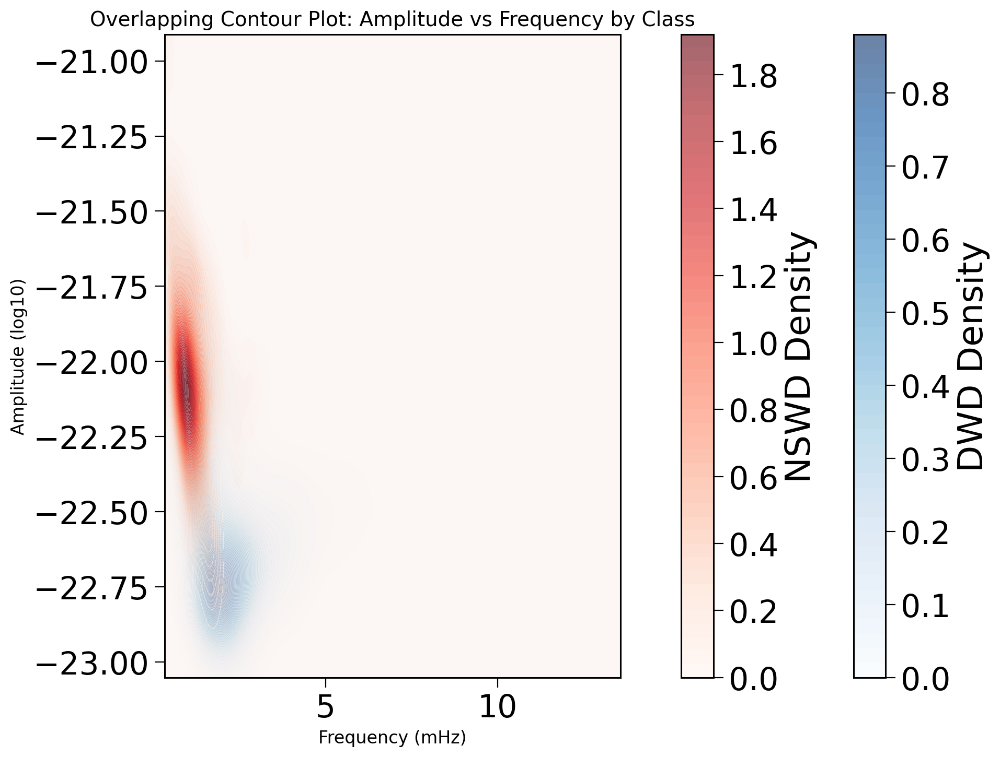

In [80]:
plot_fisher_relation_contour_overlap(df)

# Chirp Mass and fdot and f

In [139]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708
...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635


In [140]:
df['class'] = df['Binary'].str.extract(r'MW_(DWD|NSWD)')

In [141]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass,class
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554,DWD
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708,DWD
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708,DWD
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708,DWD
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708,DWD
...,...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515,DWD
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483,DWD
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333,DWD
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635,NSWD


In [142]:
def sigma_get_Mc(f0, fdot, sigma_f0, sigma_fdot, sigma_ffdot):
    pmpf = SPEED_OF_LIGHT**3/GM_SUN * ( (5/96) * np.pi**(-8/3)* fdot)**(3/5) * f0**(-16/5) * (-33/15)
    pmpfdot = SPEED_OF_LIGHT**3/GM_SUN * ( (5/96) * np.pi**(-8/3)*f0**(-11/3))**(3/5) * fdot**(-2/5) * (3/5)
    return pmpf**2 * sigma_f0**2 + pmpfdot**2 * sigma_fdot**2 + 2 * pmpf * pmpfdot * sigma_ffdot

In [143]:
# Now add the new column using the function
df['ChirpMass_SolarMass_Error'] = sigma_get_Mc(
    df['Frequency_mHz'],
    10**(df['FrequencyDerivative_log10']),
    df['Frequency_mHz_error'],
    np.log(10) * 10**(df['FrequencyDerivative_log10']) * df['FrequencyDerivative_log10_error'],
    df['sigma_f_fdot']
)

In [144]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass,class,ChirpMass_SolarMass_Error
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554,DWD,6.468576e-08
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708,DWD,3.947210e-03
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708,DWD,8.400822e-01
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708,DWD,1.074894e-01
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708,DWD,1.298546e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515,DWD,1.007419e+00
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483,DWD,4.678294e-01
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333,DWD,1.214311e+01
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635,NSWD,1.956069e+02


In [154]:
fig = px.scatter(
    df,
    x="Frequency_mHz",
    y="FrequencyDerivative_log10",
    error_x="Frequency_mHz_error",
    error_y="FrequencyDerivative_log10_error",
    hover_name="Binary",
    color="class",
    title="Frequency Derivative against Frequency with Error Bars"
)
fig.update_traces(marker=dict(size=8, opacity=0.7))
fig.update_layout(
#xaxis_range=[0, 10], 
#yaxis_range=[0, ],    
title="Frequency Derivative against Frequency",
)

fig.show()

In [155]:
fig = px.scatter(
    df,
    x="Frequency_mHz",
    y="ChirpMass_SolarMass",
    error_x="Frequency_mHz_error",
    error_y="ChirpMass_SolarMass_Error",
    hover_name="Binary",
    color="class",
    title="ChirpMass against Frequency with Error Bars"
)
fig.update_traces(marker=dict(size=8, opacity=0.7))
fig.update_layout(
xaxis_range=[2, 10], 
yaxis_range=[0, 2],    
title="ChirpMass against Frequency",
)

fig.show()

In [91]:
fig = px.density_heatmap(
    df, 
    x='Frequency_mHz', 
    y='ChirpMass_SolarMass', 
    facet_col='class',  # Create facets for each class
    nbinsx=100, 
    nbinsy=100, 
    color_continuous_scale='Viridis'
)
fig.update_layout(
    title="Density Heatmap: Chirp Mass vs Frequency by Class",
    xaxis_title="Frequency (mHz)",
    yaxis_title="Chirp Mass (Solar Mass)",
    yaxis_range = [0.3,1.5]
)
fig.show()

In [89]:


fig = px.density_heatmap(df, x='Frequency_mHz', y='ChirpMass_SolarMass', nbinsx=100, nbinsy=100, color_continuous_scale='Viridis')
fig.update_layout(
    title="Density Heatmap: Chirp Mass vs Frequency",
    xaxis_title="Frequency (mHz)",
    yaxis_title="ChirpMass (Solar Mass)",
    yaxis_range = [0.3,1.5],
    yaxis=dict(
    tickmode='linear',   # Ensure evenly spaced ticks
    tick0=0.3,           # Starting tick value
    dtick=0.05)
)
    
fig.show()

In [94]:
fig = px.density_contour(
    df,
    x='Frequency_mHz', 
    y='ChirpMass_SolarMass', 
    facet_col='class',  # Create facets for each class
)
fig.update_layout(
    title="Density Heatmap: Chirp Mass vs Frequency by Class",
    xaxis_title="Frequency (mHz)",
    yaxis_title="Chirp Mass (Solar Mass)",
    xaxis_range = [0,5],
    yaxis_range = [0,2]
)
fig.show()

# Sampling from binary

In [148]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass,class,ChirpMass_SolarMass_Error
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554,DWD,6.468576e-08
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708,DWD,3.947210e-03
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708,DWD,8.400822e-01
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708,DWD,1.074894e-01
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708,DWD,1.298546e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515,DWD,1.007419e+00
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483,DWD,4.678294e-01
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333,DWD,1.214311e+01
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635,NSWD,1.956069e+02


In [149]:
df['correlation_amp_f'] = df['sigma_amp_f'] / ((df['Amplitude_log10_error'] * df['Frequency_mHz_error']) /1.52)

In [150]:
df

,Binary,Frequency_mHz_error,FrequencyDerivative_log10_error,sigma_f_fdot,sigma_amp_f,Amplitude_log10_error,Amplitude_log10,Frequency_mHz,FrequencyDerivative_log10,Eccentricity,ChirpMass_SolarMass,class,ChirpMass_SolarMass_Error,correlation_amp_f
0,MW_DWD 0,4.979466e-07,0.003466,-7.039274e-10,2.837136e-09,0.021792,-22.392716,5.831488,-9.037016,0.000000,0.432554,DWD,6.468576e-08,0.397417
1,MW_DWD 305,1.496850e-08,4.079145,-1.455843e-08,4.110728e-10,0.167240,-22.131877,1.032685,-11.988213,0.000000,0.323708,DWD,3.947210e-03,0.249600
2,MW_DWD 336,3.808480e-06,7.860230,-1.258105e-05,6.282206e-08,2.111647,-22.784182,1.394106,-11.510344,0.000000,0.323708,DWD,8.400822e-01,0.011874
3,MW_DWD 343,2.186301e-06,2.992402,-2.744071e-06,1.280873e-08,1.576089,-22.671332,1.562902,-11.328345,0.000000,0.323708,DWD,1.074894e-01,0.005650
4,MW_DWD 345,2.716796e-06,3.395911,-3.860295e-06,2.121906e-08,1.486846,-22.811105,1.614743,-11.276382,0.000000,0.323708,DWD,1.298546e-01,0.007984
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
892,MW_DWD 6306,3.890321e-06,8.774671,-1.431019e-05,-2.003150e-07,76.293216,-22.846883,1.376940,-11.540825,0.000000,0.333515,DWD,1.007419e+00,-0.001026
893,MW_DWD 7158,3.667685e-06,6.221992,-9.547302e-06,3.839699e-08,0.216581,-22.660627,1.489623,-11.405259,0.000000,0.568483,DWD,4.678294e-01,0.073473
894,MW_DWD 15681,3.614640e-06,19.282535,-2.916214e-05,2.487302e-08,0.415131,-22.341841,0.962333,-11.882007,0.000000,0.747333,DWD,1.214311e+01,0.025195
895,MW_NSWD_ecc1 19868,3.423731e-06,22.203334,-3.192336e-05,1.665487e-08,0.341730,-21.814900,0.579049,-11.999651,0.069574,0.750635,NSWD,1.956069e+02,0.021637


In [ ]:
covariance_matrix

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following families were found: TX Times
findfont: Generic family 'serif' not found because none of the following 

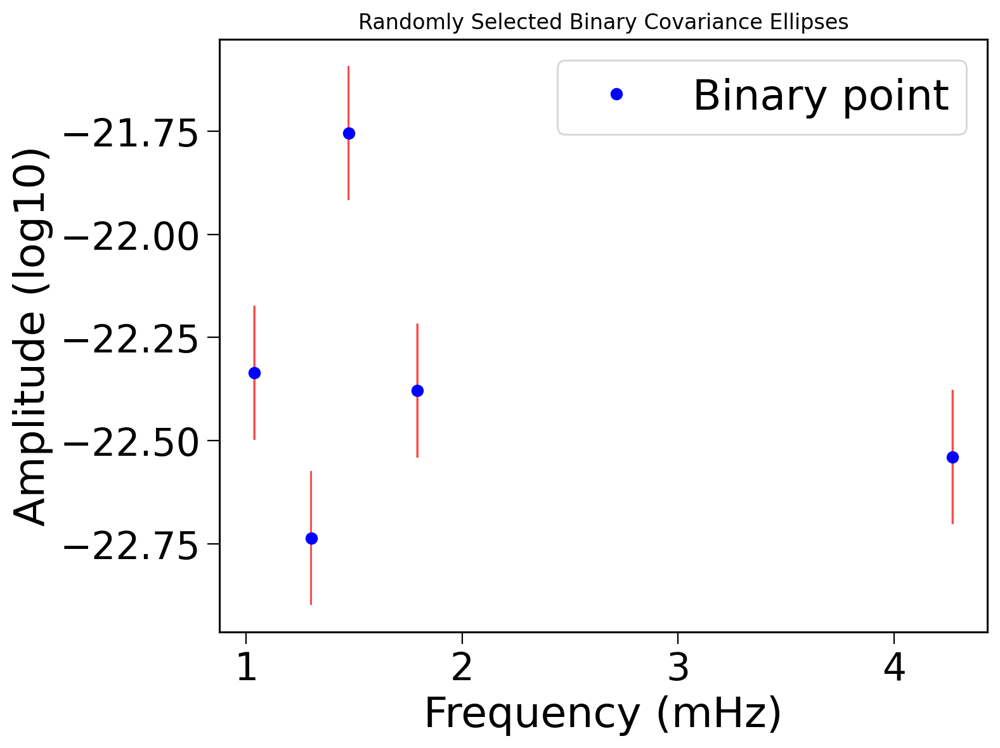

In [151]:
# If you have more than 10 rows, randomly select 10:
if len(df) > 10:
    df_sample = df.sample(5, random_state=42)
else:
    df_sample = df

fig, ax = plt.subplots(figsize=(8, 6))

for idx, row in df_sample.iterrows():
    freq = row['Frequency_mHz']
    amp = row['Amplitude_log10']
    sigma_f = row['Frequency_mHz_error']
    sigma_a = row['Amplitude_log10_error']
    rho = row['correlation_amp_f']
    
    # Covariance matrix
    cov = np.array([
        [covariance_matrix[0,0], covariance_matrix[0,4]],
        [covariance_matrix[0,4], covariance_matrix[4,4]]
    ])
    
    # Perform eigen-decomposition
    eigvals, eigvecs = np.linalg.eigh(cov)
    
    # Sort eigenvalues/eigenvectors by largest eigenvalue
    order = np.argsort(eigvals)[::-1]
    eigvals = eigvals[order]
    eigvecs = eigvecs[:, order]
    
    # Semi-major and semi-minor axes (1-sigma)
    a = np.sqrt(eigvals[0])
    b = np.sqrt(eigvals[1])
    
    # Angle of the ellipse in degrees
    # Eigenvector for the largest eigenvalue
    vx, vy = eigvecs[:,0]
    theta = np.degrees(np.arctan2(vy, vx))
    
    # Plot the center point
    ax.plot(freq, amp, 'o', color='blue', label='Binary point' if idx == df_sample.index[0] else "")
    
    # Draw the error ellipse
    ellipse = Ellipse((freq, amp), width=2*a, height=2*b,
                      angle=theta, edgecolor='red', facecolor='none', alpha=0.7)
    ax.add_patch(ellipse)

ax.set_xlabel('Frequency (mHz)')
ax.set_ylabel('Amplitude (log10)')
ax.set_title('Randomly Selected Binary Covariance Ellipses')
ax.legend(loc='best')
plt.tight_layout()
plt.show()